| Name | Mail | Phone number |
| --- | --- | --- |
| Salma Elgendy | salmasolly967@gmail.com | 01155118388 |

In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST # Training dataset
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28)):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in a uniform grid.
    '''
    image_unflat = image_tensor.detach().cpu().view(-1, *size)
    image_grid = make_grid(image_unflat[:num_images], nrow=5)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.show()

In [4]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_generator_block
def get_generator_block(input_dim, output_dim, batch_norm = None):
    '''
    Function for returning a block of the generator's neural network
    given input and output dimensions.
    Parameters:
        input_dim: the dimension of the input vector, a scalar
        output_dim: the dimension of the output vector, a scalar
    Returns:
        a generator neural network layer, with a linear transformation 
          followed by a batch normalization and then a relu activation
    '''
    if(batch_norm):
      model = nn.Sequential(
        nn.Linear(input_dim, output_dim),
        nn.BatchNorm1d(output_dim),
        nn.ReLU(inplace=True),
        ####
    )
    else:
        model = nn.Sequential(
        nn.Linear(input_dim, output_dim),
        nn.ReLU(inplace=True),
        ####
    ) 
    return model

In [11]:
# Verify the generator block function
def test_gen_block_noNorm(in_features, out_features, num_test=1000):
    block = get_generator_block(in_features, out_features, batch_norm = False)

    # Check the three parts
    assert len(block) == 2
    assert type(block[0]) == nn.Linear
    #assert type(block[1]) == nn.BatchNorm1d
    assert type(block[1]) == nn.ReLU
    
    # Check the output shape
    test_input = torch.randn(num_test, in_features)
    test_output = block(test_input)
    assert tuple(test_output.shape) == (num_test, out_features)
    #assert test_output.std() > 0.55
    assert test_output.std() < 0.65

test_gen_block_noNorm(25, 12)
test_gen_block_noNorm(15, 28)
print("Success!")

Success!


In [7]:
# Verify the generator block function
def test_gen_block(in_features, out_features, num_test=1000):
    block = get_generator_block(in_features, out_features, batch_norm = True)

    # Check the three parts
    assert len(block) == 3
    assert type(block[0]) == nn.Linear
    assert type(block[1]) == nn.BatchNorm1d
    assert type(block[2]) == nn.ReLU
    
    # Check the output shape
    test_input = torch.randn(num_test, in_features)
    test_output = block(test_input)
    assert tuple(test_output.shape) == (num_test, out_features)
    assert test_output.std() > 0.55
    assert test_output.std() < 0.65

test_gen_block(25, 12)
test_gen_block(15, 28)
print("Success!")

Success!


## A GAN with linear layers only. No weight normalization

In [12]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: Generator
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        z_dim: the dimension of the noise vector, a scalar
        im_dim: the dimension of the images, fitted for the dataset used, a scalar
          (MNIST images are 28 x 28 = 784 so that is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, z_dim=10, im_dim=784, hidden_dim=128):
        super(Generator, self).__init__()
        # Build the neural network
        self.gen = nn.Sequential(
            get_generator_block(z_dim, hidden_dim, batch_norm = False),
            get_generator_block(hidden_dim, hidden_dim * 2, batch_norm = False),
            get_generator_block(hidden_dim * 2, hidden_dim * 4, batch_norm = False),
            get_generator_block(hidden_dim * 4, hidden_dim * 8, batch_norm = False),
            # There is a dropdown with hints if you need them! 
            #### START CODE HERE ####
            nn.Linear(hidden_dim * 8, im_dim),
            nn.Sigmoid()
            #### END CODE HERE ####
        )
    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor, 
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, z_dim)
        '''
        return self.gen(noise)
    
    # Needed for grading
    def get_gen(self):
        '''
        Returns:
            the sequential model
        '''
        return self.gen

In [14]:
# Verify the generator class
def test_generator(z_dim, im_dim, hidden_dim, num_test=10000):
    gen = Generator(z_dim, im_dim, hidden_dim).get_gen()
    
    # Check there are six modules in the sequential part
    assert len(gen) == 6
    assert str(gen.__getitem__(4)).replace(' ', '') == f'Linear(in_features={hidden_dim * 8},out_features={im_dim},bias=True)'
    assert str(gen.__getitem__(5)).replace(' ', '') == 'Sigmoid()'
    test_input = torch.randn(num_test, z_dim)
    test_output = gen(test_input)

    # Check that the output shape is correct
    assert tuple(test_output.shape) == (num_test, im_dim)
    assert test_output.max() < 1, "Make sure to use a sigmoid"
    assert test_output.min() > 0, "Make sure to use a sigmoid"
    #assert test_output.std() > 0.05, "Don't use batchnorm here"
    #assert test_output.std() < 0.15, "Don't use batchnorm here"

test_generator(5, 10, 20)
test_generator(20, 8, 24)
print("Success!")

Success!


In [15]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_noise
def get_noise(n_samples, z_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, z_dim),
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
        n_samples: the number of samples to generate, a scalar
        z_dim: the dimension of the noise vector, a scalar
        device: the device type
    '''
    # NOTE: To use this on GPU with device='cuda', make sure to pass the device 
    # argument to the function you use to generate the noise.
    #### START CODE HERE ####
    return torch.randn(n_samples,z_dim,device=device)
    #### END CODE HERE ####

In [16]:
# Verify the noise vector function
def test_get_noise(n_samples, z_dim, device='cpu'):
    noise = get_noise(n_samples, z_dim, device)
    
    # Make sure a normal distribution was used
    assert tuple(noise.shape) == (n_samples, z_dim)
    assert torch.abs(noise.std() - torch.tensor(1.0)) < 0.01
    assert str(noise.device).startswith(device)

test_get_noise(1000, 100, 'cpu')
if torch.cuda.is_available():
    test_get_noise(1000, 32, 'cuda')
print("Success!")

Success!


In [17]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_discriminator_block
def get_discriminator_block(input_dim, output_dim):
    '''
    Discriminator Block
    Function for returning a neural network of the discriminator given input and output dimensions.
    Parameters:
        input_dim: the dimension of the input vector, a scalar
        output_dim: the dimension of the output vector, a scalar
    Returns:
        a discriminator neural network layer, with a linear transformation 
          followed by an nn.LeakyReLU activation with negative slope of 0.2 
          (https://pytorch.org/docs/master/generated/torch.nn.LeakyReLU.html)
    '''
    return nn.Sequential(
        #### START CODE HERE ####
         nn.Linear(input_dim, output_dim), #Layer 1
         nn.LeakyReLU(0.2, inplace=True)
        #### END CODE HERE ####
    )

In [18]:
# Verify the discriminator block function
def test_disc_block(in_features, out_features, num_test=10000):
    block = get_discriminator_block(in_features, out_features)

    # Check there are two parts
    assert len(block) == 2
    test_input = torch.randn(num_test, in_features)
    test_output = block(test_input)

    # Check that the shape is right
    assert tuple(test_output.shape) == (num_test, out_features)
    
    # Check that the LeakyReLU slope is about 0.2
    assert -test_output.min() / test_output.max() > 0.1
    assert -test_output.min() / test_output.max() < 0.3
    assert test_output.std() > 0.3
    assert test_output.std() < 0.5
    
    assert str(block.__getitem__(0)).replace(' ', '') == f'Linear(in_features={in_features},out_features={out_features},bias=True)'        
    assert str(block.__getitem__(1)).replace(' ', '').replace(',inplace=True', '') == 'LeakyReLU(negative_slope=0.2)'


test_disc_block(25, 12)
test_disc_block(15, 28)
print("Success!")

Success!


In [19]:
# UNQ_C5 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: Discriminator
class Discriminator(nn.Module):
    '''
    Discriminator Class
    Values:
        im_dim: the dimension of the images, fitted for the dataset used, a scalar
            (MNIST images are 28x28 = 784 so that is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_dim=784, hidden_dim=128):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            get_discriminator_block(im_dim, hidden_dim * 4),
            get_discriminator_block(hidden_dim * 4, hidden_dim * 2),
            get_discriminator_block(hidden_dim * 2, hidden_dim),
            # Hint: You want to transform the final output into a single value,
            #       so add one more linear map.
            #### START CODE HERE ####
            nn.Linear(hidden_dim, 1)
            #### END CODE HERE ####
        )

    def forward(self, image):
        '''
        Function for completing a forward pass of the discriminator: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_dim)
        '''
        return self.disc(image)
    
    # Needed for grading
    def get_disc(self):
        '''
        Returns:
            the sequential model
        '''
        return self.disc

In [20]:
# Verify the discriminator class
def test_discriminator(z_dim, hidden_dim, num_test=100):
    
    disc = Discriminator(z_dim, hidden_dim).get_disc()

    # Check there are three parts
    assert len(disc) == 4
    assert type(disc.__getitem__(3)) == nn.Linear

    # Check the linear layer is correct
    test_input = torch.randn(num_test, z_dim)
    test_output = disc(test_input)
    assert tuple(test_output.shape) == (num_test, 1)

test_discriminator(5, 10)
test_discriminator(20, 8)
print("Success!")

Success!


In [21]:
# Set your parameters
criterion = nn.BCEWithLogitsLoss()
n_epochs = 200
z_dim = 64
display_step = 500
batch_size = 128
lr = 0.00001
device = 'cuda'
# Load MNIST dataset as tensors
dataloader = DataLoader(
    MNIST('.', download=True, transform=transforms.ToTensor()),
    batch_size=batch_size,
    shuffle=True)

  0%|          | 0/9912422 [00:00<?, ?it/s]

Extracting ./MNIST/raw/train-images-idx3-ubyte.gz to ./MNIST/raw



  0%|          | 0/28881 [00:00<?, ?it/s]

Extracting ./MNIST/raw/train-labels-idx1-ubyte.gz to ./MNIST/raw



  0%|          | 0/1648877 [00:00<?, ?it/s]

Extracting ./MNIST/raw/t10k-images-idx3-ubyte.gz to ./MNIST/raw



  0%|          | 0/4542 [00:00<?, ?it/s]

Extracting ./MNIST/raw/t10k-labels-idx1-ubyte.gz to ./MNIST/raw



In [22]:
gen = Generator(z_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator().to(device) 
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

In [23]:
# UNQ_C6 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_disc_loss
def get_disc_loss(gen, disc, criterion, real, num_images, z_dim, device):
    '''
    Return the loss of the discriminator given inputs.
    Parameters:
        gen: the generator model, which returns an image given z-dimensional noise
        disc: the discriminator model, which returns a single-dimensional prediction of real/fake
        criterion: the loss function, which should be used to compare 
               the discriminator's predictions to the ground truth reality of the images 
               (e.g. fake = 0, real = 1)
        real: a batch of real images
        num_images: the number of images the generator should produce, 
                which is also the length of the real images
        z_dim: the dimension of the noise vector, a scalar
        device: the device type
    Returns:
        disc_loss: a torch scalar loss value for the current batch
    '''
    #     These are the steps you will need to complete:
    #       1) Create noise vectors and generate a batch (num_images) of fake images. 
    #            Make sure to pass the device argument to the noise.
    #       2) Get the discriminator's prediction of the fake image 
    #            and calculate the loss. Don't forget to detach the generator!
    #            (Remember the loss function you set earlier -- criterion. You need a 
    #            'ground truth' tensor in order to calculate the loss. 
    #            For example, a ground truth tensor for a fake image is all zeros.)
    #       3) Get the discriminator's prediction of the real image and calculate the loss.
    #       4) Calculate the discriminator's loss by averaging the real and fake loss
    #            and set it to disc_loss.
    #     *Important*: You should NOT write your own loss function here - use criterion(pred, true)!
    #### START CODE HERE ####
    fake_noise = get_noise(num_images, z_dim, device=device)
    fake = gen(fake_noise)
    disc_fake_pred = disc(fake.detach())
    disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
    disc_real_pred = disc(real)
    disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
    disc_loss = (disc_fake_loss + disc_real_loss) / 2
    #### END CODE HERE ####
    return disc_loss

In [24]:
def test_disc_reasonable(num_images=10):
    z_dim = 64
    gen = torch.zeros_like
    disc = nn.Identity()
    criterion = torch.mul # Multiply
    real = torch.ones(num_images, 1)
    disc_loss = get_disc_loss(gen, disc, criterion, real, num_images, z_dim, 'cpu')
    assert tuple(disc_loss.shape) == (num_images, z_dim)
    assert torch.all(torch.abs(disc_loss - 0.5) < 1e-5)

    gen = torch.ones_like
    disc = nn.Identity()
    criterion = torch.mul # Multiply
    real = torch.zeros(num_images, 1)
    assert torch.all(torch.abs(get_disc_loss(gen, disc, criterion, real, num_images, z_dim, 'cpu')) < 1e-5)

def test_disc_loss(max_tests = 10):
    z_dim = 64
    gen = Generator(z_dim).to(device)
    gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
    disc = Discriminator().to(device) 
    disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)
    num_steps = 0
    for real, _ in dataloader:
        cur_batch_size = len(real)
        real = real.view(cur_batch_size, -1).to(device)

        ### Update discriminator ###
        # Zero out the gradient before backpropagation
        disc_opt.zero_grad()

        # Calculate discriminator loss
        disc_loss = get_disc_loss(gen, disc, criterion, real, cur_batch_size, z_dim, device)
        assert (disc_loss - 0.68).abs() < 0.05

        # Update gradients
        disc_loss.backward(retain_graph=True)

        # Check that they detached correctly
        assert gen.gen[0][0].weight.grad is None

        # Update optimizer
        old_weight = disc.disc[0][0].weight.data.clone()
        disc_opt.step()
        new_weight = disc.disc[0][0].weight.data
        
        # Check that some discriminator weights changed
        assert not torch.all(torch.eq(old_weight, new_weight))
        num_steps += 1
        if num_steps >= max_tests:
            break

test_disc_reasonable()
test_disc_loss()
print("Success!")


Success!


In [25]:
# UNQ_C7 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_gen_loss
def get_gen_loss(gen, disc, criterion, num_images, z_dim, device):
    '''
    Return the loss of the generator given inputs.
    Parameters:
        gen: the generator model, which returns an image given z-dimensional noise
        disc: the discriminator model, which returns a single-dimensional prediction of real/fake
        criterion: the loss function, which should be used to compare 
               the discriminator's predictions to the ground truth reality of the images 
               (e.g. fake = 0, real = 1)
        num_images: the number of images the generator should produce, 
                which is also the length of the real images
        z_dim: the dimension of the noise vector, a scalar
        device: the device type
    Returns:
        gen_loss: a torch scalar loss value for the current batch
    '''
    #     These are the steps you will need to complete:
    #       1) Create noise vectors and generate a batch of fake images. 
    #           Remember to pass the device argument to the get_noise function.
    #       2) Get the discriminator's prediction of the fake image.
    #       3) Calculate the generator's loss. Remember the generator wants
    #          the discriminator to think that its fake images are real
    #     *Important*: You should NOT write your own loss function here - use criterion(pred, true)!

    #### START CODE HERE ####
    fake_noise = get_noise(num_images, z_dim, device=device)
    fake = gen(fake_noise)
    disc_fake_pred = disc(fake)
    gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
    #### END CODE HERE ####
    return gen_loss

In [26]:
def test_gen_reasonable(num_images=10):
    z_dim = 64
    gen = torch.zeros_like
    disc = nn.Identity()
    criterion = torch.mul # Multiply
    gen_loss_tensor = get_gen_loss(gen, disc, criterion, num_images, z_dim, 'cpu')
    assert torch.all(torch.abs(gen_loss_tensor) < 1e-5)
    #Verify shape. Related to gen_noise parametrization
    assert tuple(gen_loss_tensor.shape) == (num_images, z_dim)

    gen = torch.ones_like
    disc = nn.Identity()
    criterion = torch.mul # Multiply
    real = torch.zeros(num_images, 1)
    gen_loss_tensor = get_gen_loss(gen, disc, criterion, num_images, z_dim, 'cpu')
    assert torch.all(torch.abs(gen_loss_tensor - 1) < 1e-5)
    #Verify shape. Related to gen_noise parametrization
    assert tuple(gen_loss_tensor.shape) == (num_images, z_dim)
    

def test_gen_loss(num_images):
    z_dim = 64
    gen = Generator(z_dim).to(device)
    gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
    disc = Discriminator().to(device) 
    disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)
    
    gen_loss = get_gen_loss(gen, disc, criterion, num_images, z_dim, device)
    
    # Check that the loss is reasonable
    assert (gen_loss - 0.7).abs() < 0.1
    gen_loss.backward()
    old_weight = gen.gen[0][0].weight.clone()
    gen_opt.step()
    new_weight = gen.gen[0][0].weight
    assert not torch.all(torch.eq(old_weight, new_weight))
  
test_gen_reasonable(10)
test_gen_loss(18)
print("Success!")

Success!


  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 500: Generator loss: 1.1398143218755734, discriminator loss: 0.49022912269830715


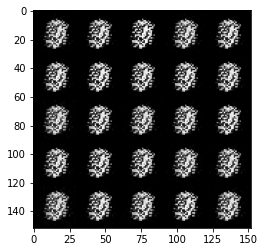

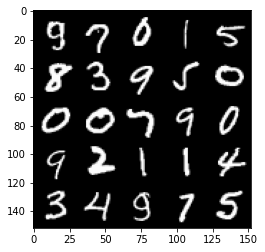

  0%|          | 0/469 [00:00<?, ?it/s]

Step 1000: Generator loss: 1.0167212789058695, discriminator loss: 0.5530330026149748


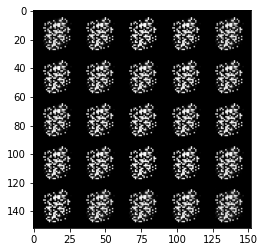

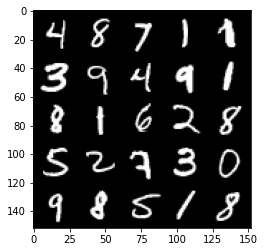

  0%|          | 0/469 [00:00<?, ?it/s]

Step 1500: Generator loss: 1.0890465465784067, discriminator loss: 0.47516000759601573


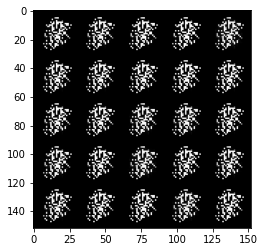

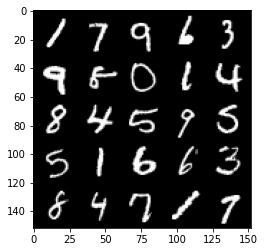

  0%|          | 0/469 [00:00<?, ?it/s]

Step 2000: Generator loss: 1.2092324630022033, discriminator loss: 0.4665099954009056


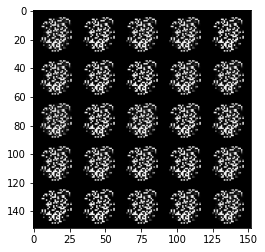

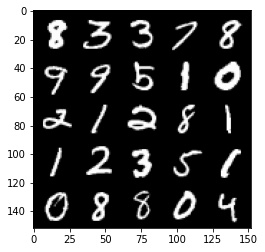

  0%|          | 0/469 [00:00<?, ?it/s]

Step 2500: Generator loss: 1.4572804083824158, discriminator loss: 0.4056199940145015


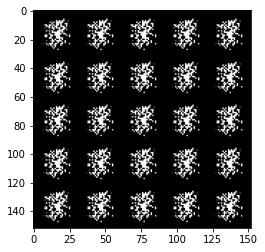

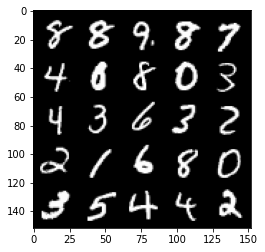

  0%|          | 0/469 [00:00<?, ?it/s]

Step 3000: Generator loss: 1.6887254221439334, discriminator loss: 0.2976599860787392


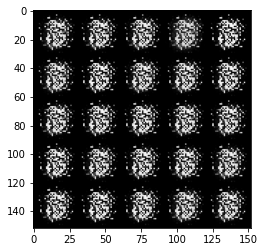

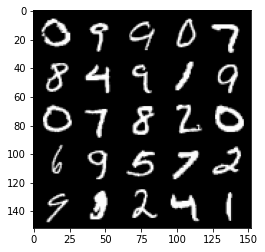

  0%|          | 0/469 [00:00<?, ?it/s]

Step 3500: Generator loss: 1.486820541858673, discriminator loss: 0.38951364880800254


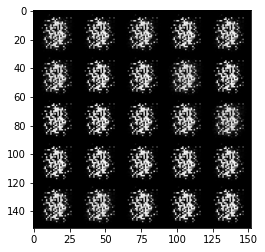

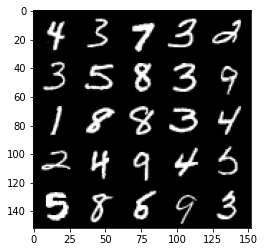

  0%|          | 0/469 [00:00<?, ?it/s]

Step 4000: Generator loss: 1.517714667797089, discriminator loss: 0.3067407422363757


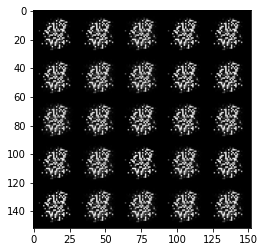

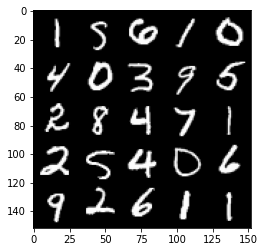

  0%|          | 0/469 [00:00<?, ?it/s]

Step 4500: Generator loss: 1.378966905593873, discriminator loss: 0.337929851949215


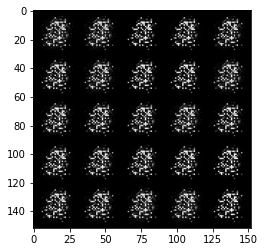

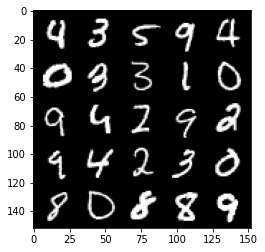

  0%|          | 0/469 [00:00<?, ?it/s]

Step 5000: Generator loss: 1.4443527977466595, discriminator loss: 0.2922070527076721


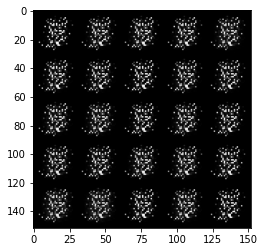

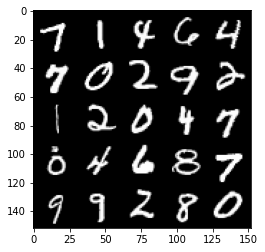

  0%|          | 0/469 [00:00<?, ?it/s]

Step 5500: Generator loss: 1.5004843943119033, discriminator loss: 0.2927473840415476


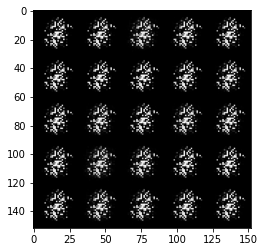

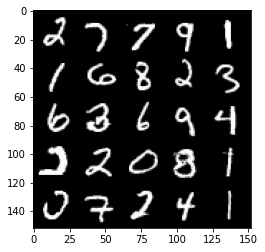

  0%|          | 0/469 [00:00<?, ?it/s]

Step 6000: Generator loss: 1.990119490623476, discriminator loss: 0.18715972742438278


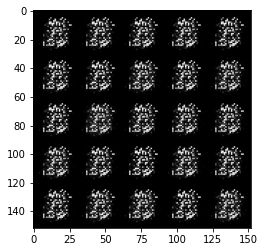

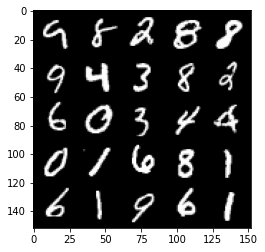

  0%|          | 0/469 [00:00<?, ?it/s]

Step 6500: Generator loss: 2.6257670850753763, discriminator loss: 0.11043069607764476


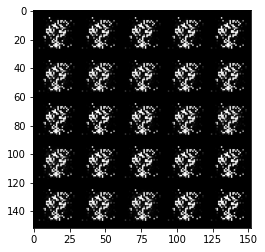

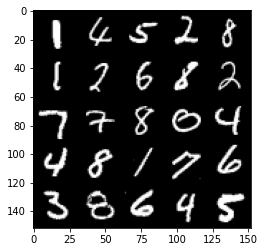

  0%|          | 0/469 [00:00<?, ?it/s]

Step 7000: Generator loss: 2.802880275249483, discriminator loss: 0.09730135080963377


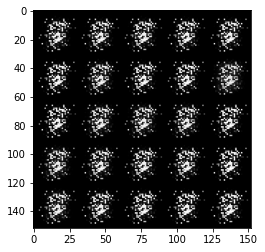

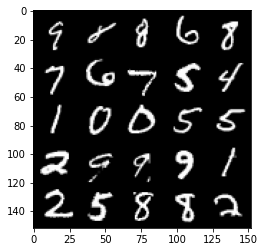

  0%|          | 0/469 [00:00<?, ?it/s]

Step 7500: Generator loss: 3.1867194042205793, discriminator loss: 0.07058510653674602


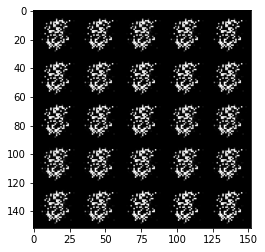

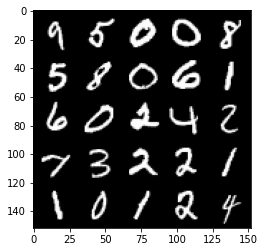

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 8000: Generator loss: 3.512527022838592, discriminator loss: 0.056060900606214985


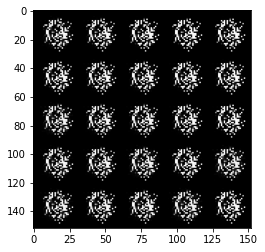

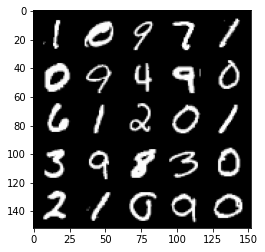

  0%|          | 0/469 [00:00<?, ?it/s]

Step 8500: Generator loss: 4.017953541278838, discriminator loss: 0.02890462882257999


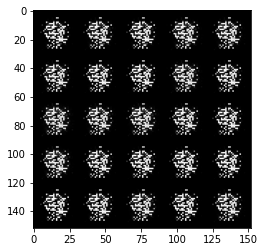

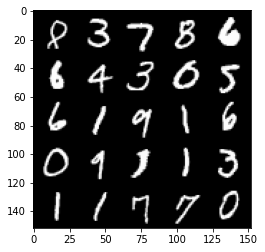

  0%|          | 0/469 [00:00<?, ?it/s]

Step 9000: Generator loss: 3.900112395763399, discriminator loss: 0.03738140724971895


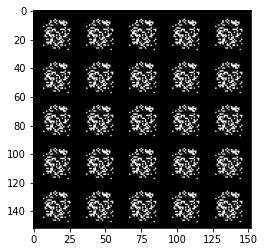

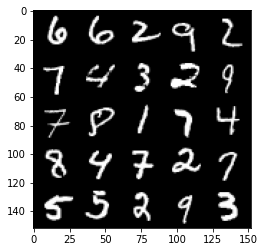

  0%|          | 0/469 [00:00<?, ?it/s]

Step 9500: Generator loss: 4.235260463237761, discriminator loss: 0.026413266181945796


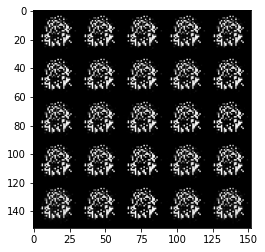

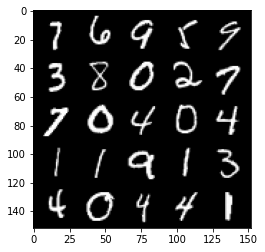

  0%|          | 0/469 [00:00<?, ?it/s]

Step 10000: Generator loss: 4.600432543754581, discriminator loss: 0.015979322309605783


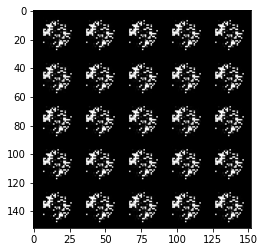

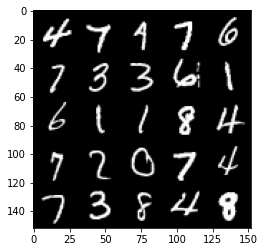

  0%|          | 0/469 [00:00<?, ?it/s]

Step 10500: Generator loss: 4.453273705959324, discriminator loss: 0.02528547012712804


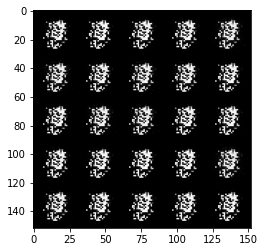

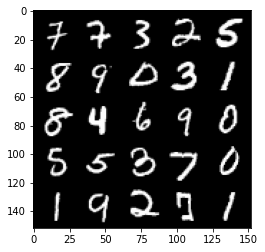

  0%|          | 0/469 [00:00<?, ?it/s]

Step 11000: Generator loss: 4.497847482681277, discriminator loss: 0.0213890936151147


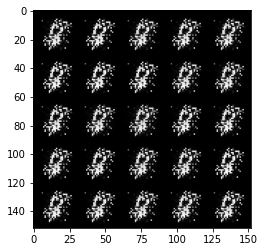

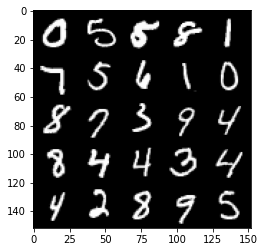

  0%|          | 0/469 [00:00<?, ?it/s]

Step 11500: Generator loss: 4.50359435749054, discriminator loss: 0.02457796015124767


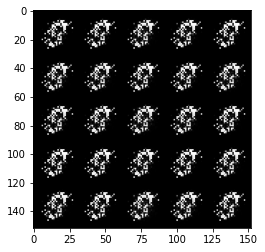

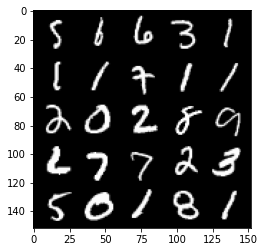

  0%|          | 0/469 [00:00<?, ?it/s]

Step 12000: Generator loss: 4.744301396369931, discriminator loss: 0.018588377389125523


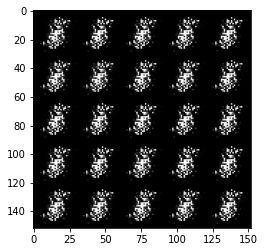

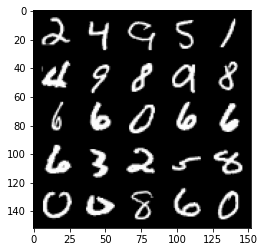

  0%|          | 0/469 [00:00<?, ?it/s]

Step 12500: Generator loss: 5.037546733856199, discriminator loss: 0.012315568616148069


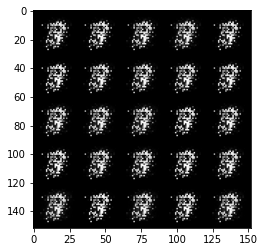

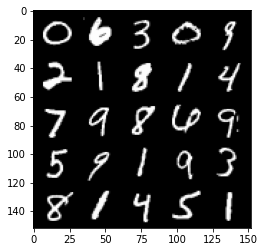

  0%|          | 0/469 [00:00<?, ?it/s]

Step 13000: Generator loss: 5.01624605941773, discriminator loss: 0.014283595777116726


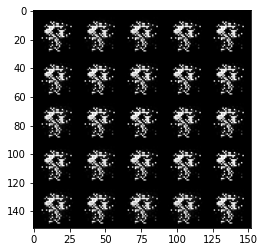

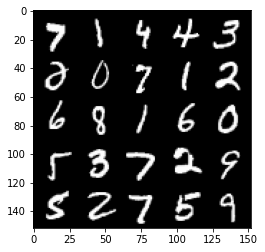

  0%|          | 0/469 [00:00<?, ?it/s]

Step 13500: Generator loss: 5.359795831680302, discriminator loss: 0.010408233201596877


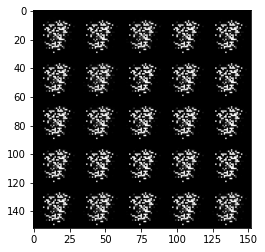

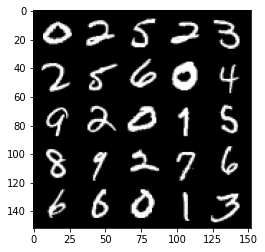

  0%|          | 0/469 [00:00<?, ?it/s]

Step 14000: Generator loss: 5.686701819419853, discriminator loss: 0.007497147452319047


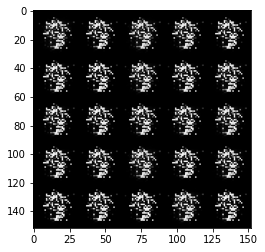

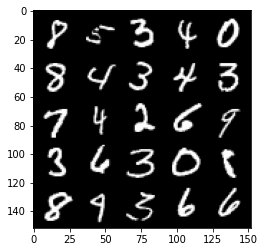

  0%|          | 0/469 [00:00<?, ?it/s]

Step 14500: Generator loss: 5.49778932666779, discriminator loss: 0.01189291627611965


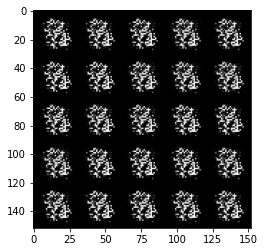

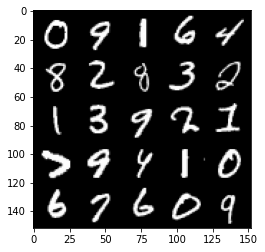

  0%|          | 0/469 [00:00<?, ?it/s]

Step 15000: Generator loss: 5.780813471794128, discriminator loss: 0.010613132630474871


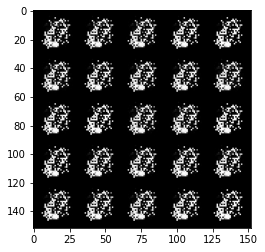

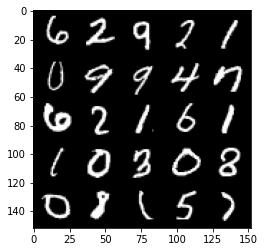

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 15500: Generator loss: 5.908690600395203, discriminator loss: 0.006318322803592305


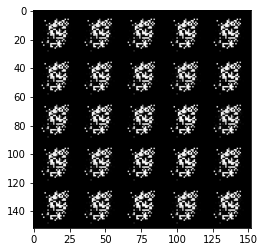

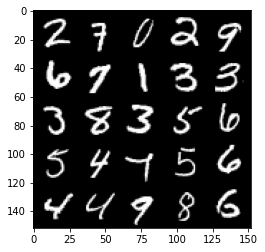

  0%|          | 0/469 [00:00<?, ?it/s]

Step 16000: Generator loss: 5.767644464492795, discriminator loss: 0.007784180544083936


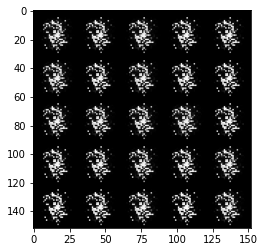

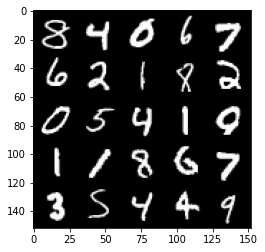

  0%|          | 0/469 [00:00<?, ?it/s]

Step 16500: Generator loss: 5.748334655761718, discriminator loss: 0.011385866252472615


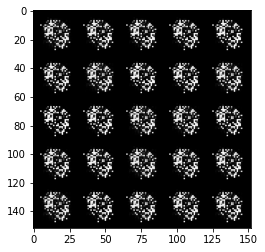

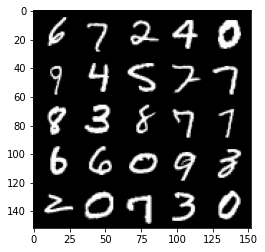

  0%|          | 0/469 [00:00<?, ?it/s]

Step 17000: Generator loss: 6.001964509010318, discriminator loss: 0.0073384603224694814


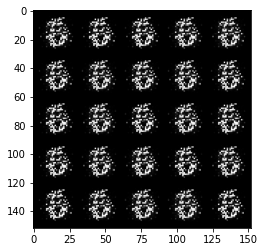

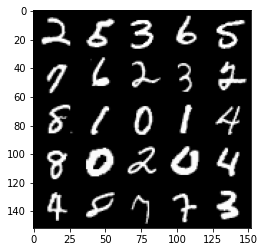

  0%|          | 0/469 [00:00<?, ?it/s]

Step 17500: Generator loss: 5.686261955261233, discriminator loss: 0.011797737290151416


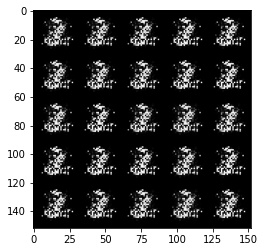

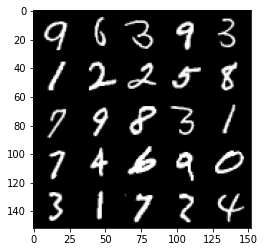

  0%|          | 0/469 [00:00<?, ?it/s]

Step 18000: Generator loss: 5.7123134393692, discriminator loss: 0.009504257438471535


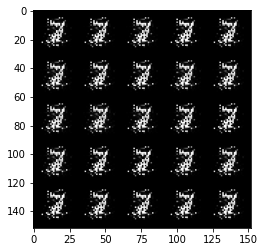

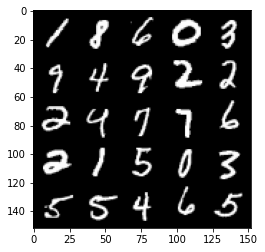

  0%|          | 0/469 [00:00<?, ?it/s]

Step 18500: Generator loss: 5.820197580337528, discriminator loss: 0.008039787926943973


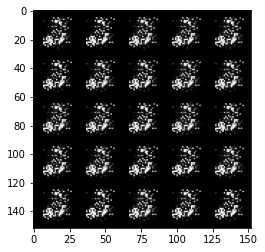

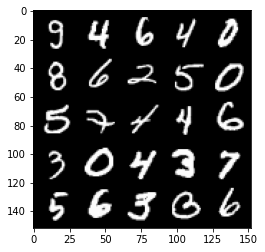

  0%|          | 0/469 [00:00<?, ?it/s]

Step 19000: Generator loss: 5.797110191345219, discriminator loss: 0.008914557085605342


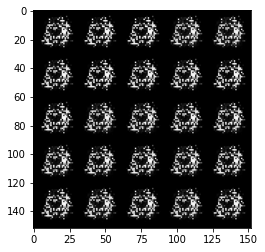

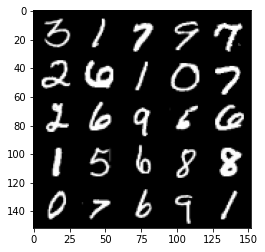

  0%|          | 0/469 [00:00<?, ?it/s]

Step 19500: Generator loss: 6.314799996376037, discriminator loss: 0.007492753481608804


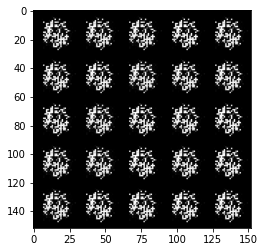

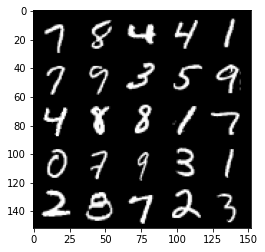

  0%|          | 0/469 [00:00<?, ?it/s]

Step 20000: Generator loss: 6.529438569068911, discriminator loss: 0.005351590315869535


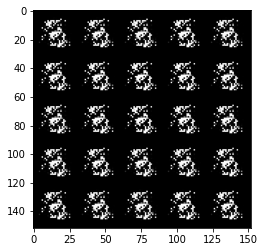

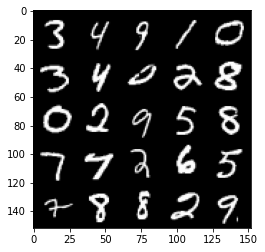

  0%|          | 0/469 [00:00<?, ?it/s]

Step 20500: Generator loss: 6.409811437606818, discriminator loss: 0.0052144756054040035


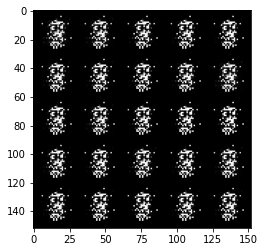

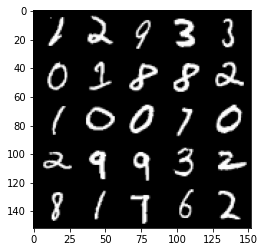

  0%|          | 0/469 [00:00<?, ?it/s]

Step 21000: Generator loss: 6.127725238800049, discriminator loss: 0.007425199569668621


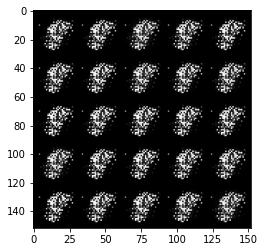

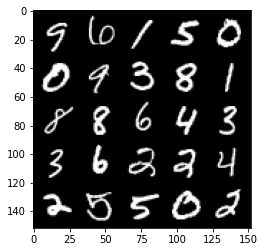

  0%|          | 0/469 [00:00<?, ?it/s]

Step 21500: Generator loss: 6.357948690414432, discriminator loss: 0.0063914788271649675


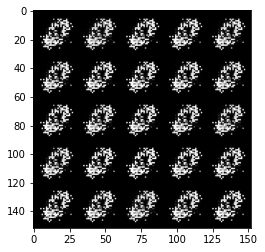

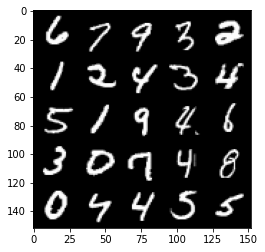

  0%|          | 0/469 [00:00<?, ?it/s]

Step 22000: Generator loss: 6.3647229347229, discriminator loss: 0.006102225028560495


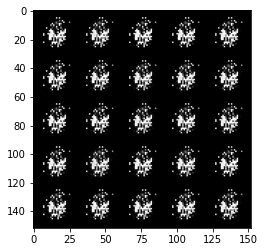

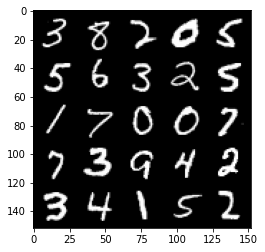

  0%|          | 0/469 [00:00<?, ?it/s]

Step 22500: Generator loss: 6.354266298294069, discriminator loss: 0.005641860210802408


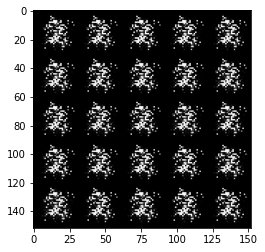

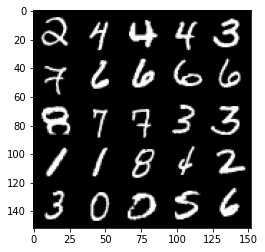

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 23000: Generator loss: 6.740709947586052, discriminator loss: 0.0066547606055391935


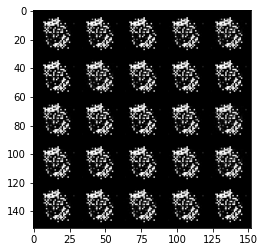

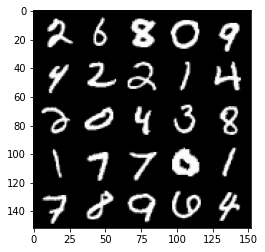

  0%|          | 0/469 [00:00<?, ?it/s]

Step 23500: Generator loss: 6.274719031333925, discriminator loss: 0.007046040189685309


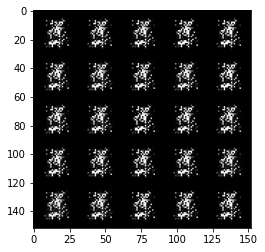

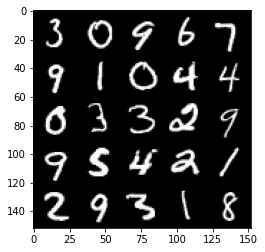

  0%|          | 0/469 [00:00<?, ?it/s]

Step 24000: Generator loss: 6.324375273704533, discriminator loss: 0.008370676871738402


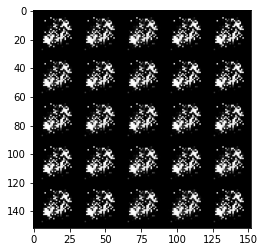

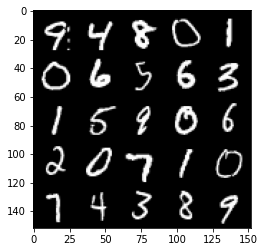

  0%|          | 0/469 [00:00<?, ?it/s]

Step 24500: Generator loss: 6.561862569808959, discriminator loss: 0.006096308367094025


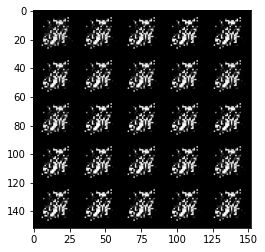

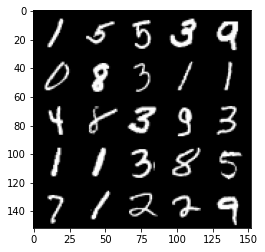

  0%|          | 0/469 [00:00<?, ?it/s]

Step 25000: Generator loss: 6.133968670845025, discriminator loss: 0.006716769263381145


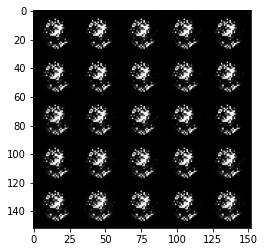

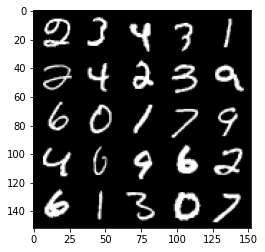

  0%|          | 0/469 [00:00<?, ?it/s]

Step 25500: Generator loss: 6.196903203010565, discriminator loss: 0.01031619645119644


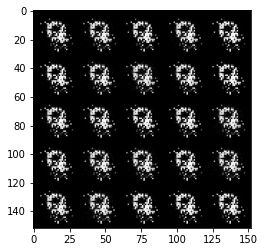

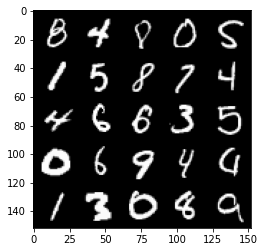

  0%|          | 0/469 [00:00<?, ?it/s]

Step 26000: Generator loss: 6.102600239753729, discriminator loss: 0.008227126913378024


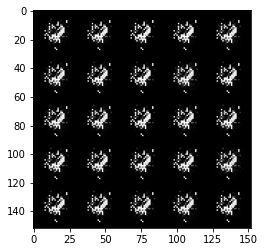

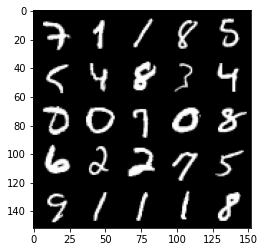

  0%|          | 0/469 [00:00<?, ?it/s]

Step 26500: Generator loss: 6.397456474304201, discriminator loss: 0.007068630872177898


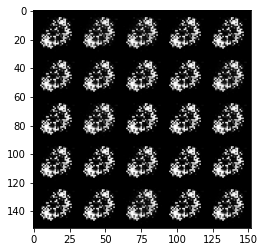

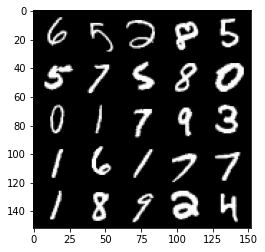

  0%|          | 0/469 [00:00<?, ?it/s]

Step 27000: Generator loss: 6.618638798713683, discriminator loss: 0.0072265186358708875


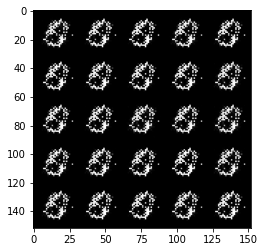

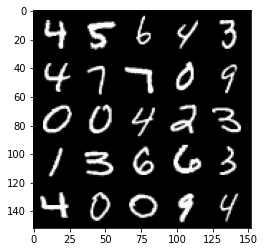

  0%|          | 0/469 [00:00<?, ?it/s]

Step 27500: Generator loss: 6.0250849742889425, discriminator loss: 0.011287724305992008


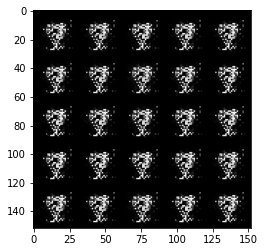

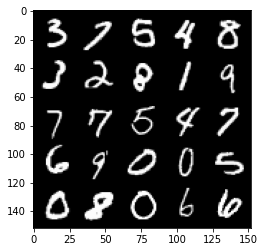

  0%|          | 0/469 [00:00<?, ?it/s]

Step 28000: Generator loss: 6.368543355941769, discriminator loss: 0.008070394769485574


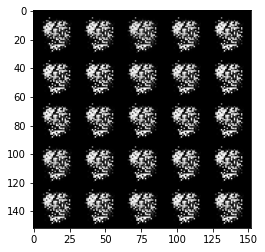

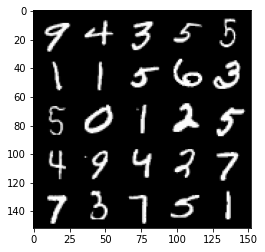

  0%|          | 0/469 [00:00<?, ?it/s]

Step 28500: Generator loss: 6.619965040206909, discriminator loss: 0.007068435108230914


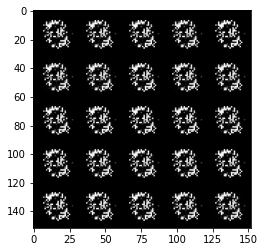

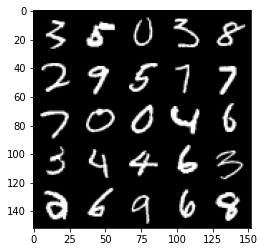

  0%|          | 0/469 [00:00<?, ?it/s]

Step 29000: Generator loss: 6.141775256156923, discriminator loss: 0.011383911430137238


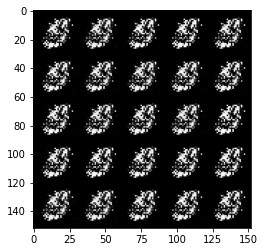

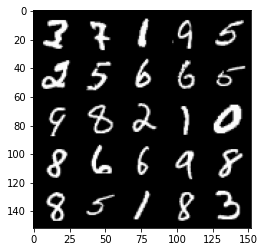

  0%|          | 0/469 [00:00<?, ?it/s]

Step 29500: Generator loss: 6.372643516540527, discriminator loss: 0.009586487470660371


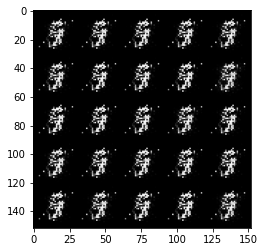

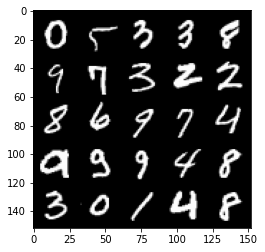

  0%|          | 0/469 [00:00<?, ?it/s]

Step 30000: Generator loss: 5.9098541431427, discriminator loss: 0.007954321930184966


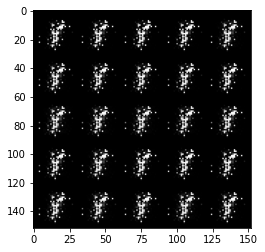

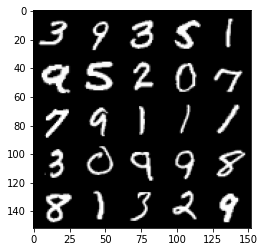

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 30500: Generator loss: 5.788399186134334, discriminator loss: 0.008555477865738799


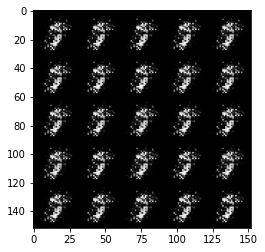

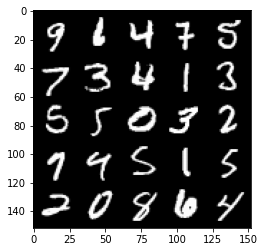

  0%|          | 0/469 [00:00<?, ?it/s]

Step 31000: Generator loss: 5.6238156871795635, discriminator loss: 0.016746475342893977


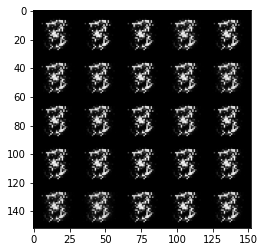

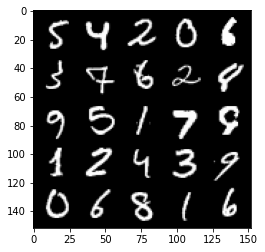

  0%|          | 0/469 [00:00<?, ?it/s]

Step 31500: Generator loss: 5.781176413536067, discriminator loss: 0.017661300521343952


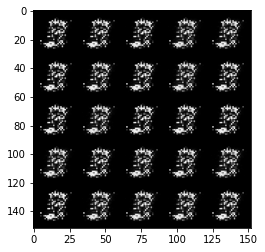

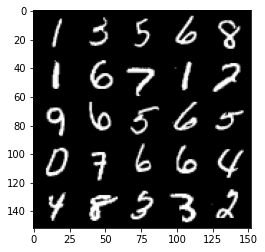

  0%|          | 0/469 [00:00<?, ?it/s]

Step 32000: Generator loss: 6.3531891412735, discriminator loss: 0.008508112398645592


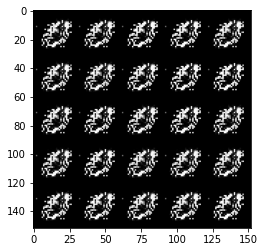

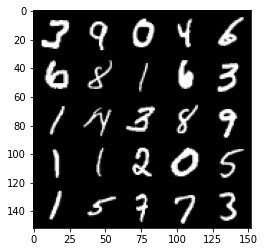

  0%|          | 0/469 [00:00<?, ?it/s]

Step 32500: Generator loss: 6.896519042968749, discriminator loss: 0.004618382320913954


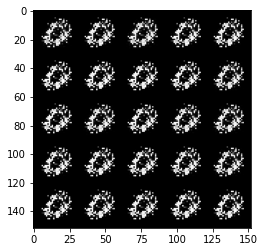

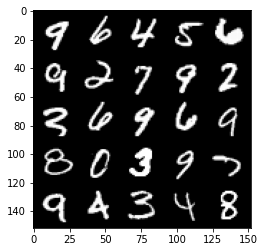

  0%|          | 0/469 [00:00<?, ?it/s]

Step 33000: Generator loss: 6.519838410377502, discriminator loss: 0.005322817525418938


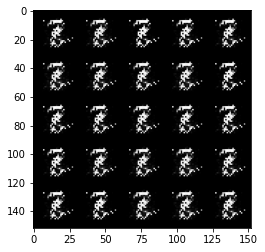

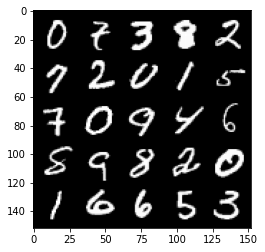

  0%|          | 0/469 [00:00<?, ?it/s]

Step 33500: Generator loss: 6.959001769065859, discriminator loss: 0.0074496280538151015


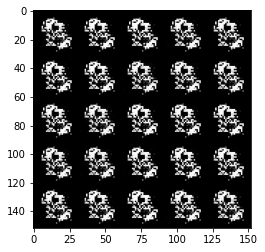

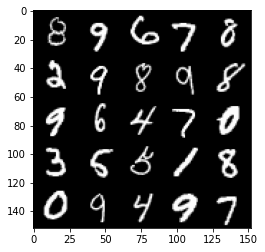

  0%|          | 0/469 [00:00<?, ?it/s]

Step 34000: Generator loss: 7.199136596679691, discriminator loss: 0.004653488168492913


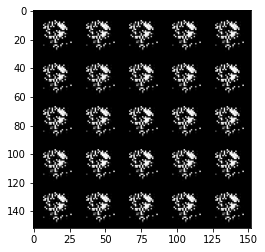

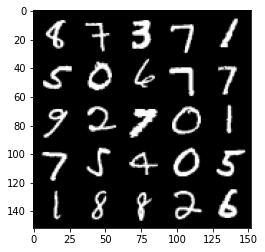

  0%|          | 0/469 [00:00<?, ?it/s]

Step 34500: Generator loss: 6.459820045471188, discriminator loss: 0.005784004402754357


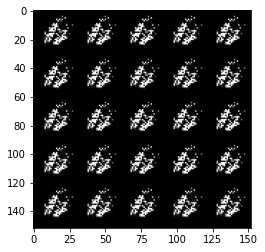

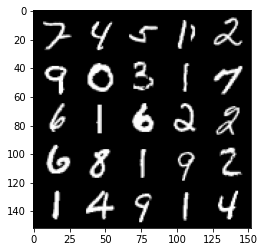

  0%|          | 0/469 [00:00<?, ?it/s]

Step 35000: Generator loss: 7.417937633514405, discriminator loss: 0.004781514248796159


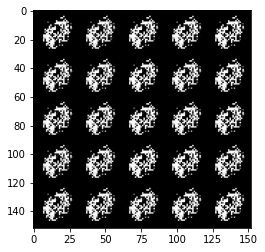

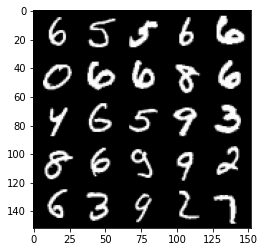

  0%|          | 0/469 [00:00<?, ?it/s]

Step 35500: Generator loss: 7.161964773178102, discriminator loss: 0.005264299634993222


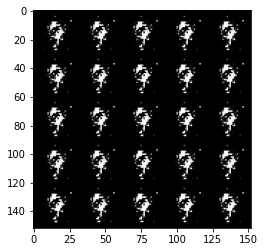

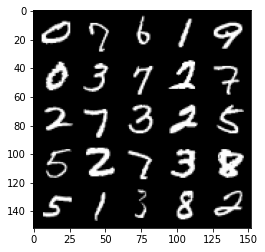

  0%|          | 0/469 [00:00<?, ?it/s]

Step 36000: Generator loss: 6.625903313636777, discriminator loss: 0.005614193609275392


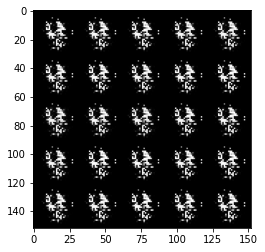

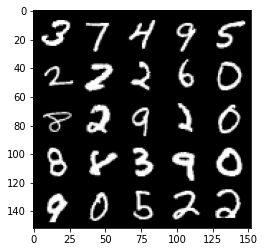

  0%|          | 0/469 [00:00<?, ?it/s]

Step 36500: Generator loss: 7.458676563262941, discriminator loss: 0.004473715416097544


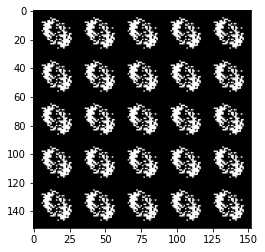

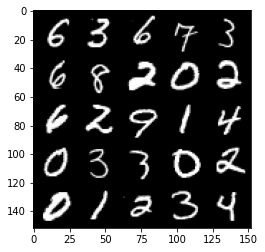

  0%|          | 0/469 [00:00<?, ?it/s]

Step 37000: Generator loss: 8.067768256187447, discriminator loss: 0.0015566841644831595


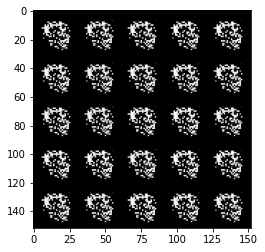

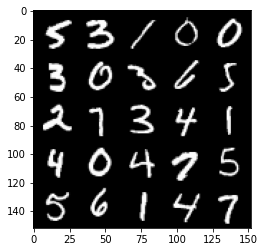

  0%|          | 0/469 [00:00<?, ?it/s]

Step 37500: Generator loss: 7.053453433036812, discriminator loss: 0.0035116864786832584


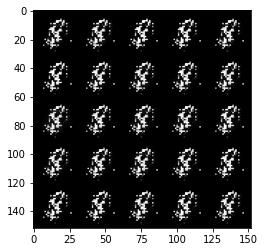

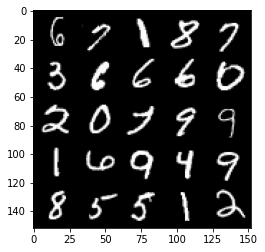

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 38000: Generator loss: 7.937910517692566, discriminator loss: 0.002623621827267924


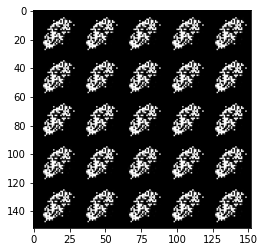

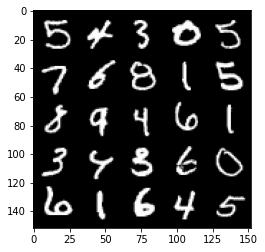

  0%|          | 0/469 [00:00<?, ?it/s]

Step 38500: Generator loss: 7.495049262046816, discriminator loss: 0.003651722843538665


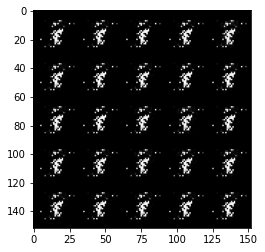

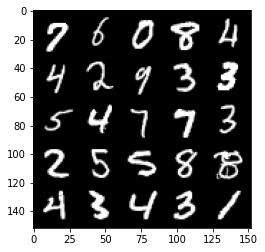

  0%|          | 0/469 [00:00<?, ?it/s]

Step 39000: Generator loss: 6.556295004844657, discriminator loss: 0.0036097260420210643


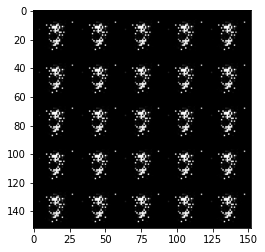

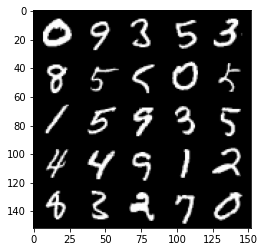

  0%|          | 0/469 [00:00<?, ?it/s]

Step 39500: Generator loss: 6.5560210237503025, discriminator loss: 0.003870201262179763


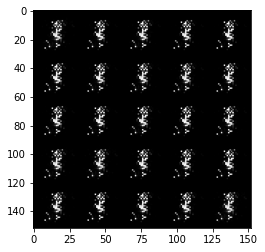

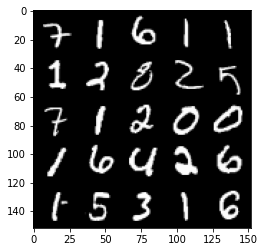

  0%|          | 0/469 [00:00<?, ?it/s]

Step 40000: Generator loss: 6.576236827850342, discriminator loss: 0.006892273871926594


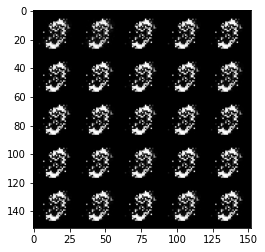

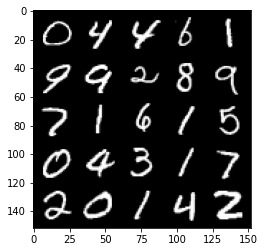

  0%|          | 0/469 [00:00<?, ?it/s]

Step 40500: Generator loss: 7.973609305381775, discriminator loss: 0.004732457945789067


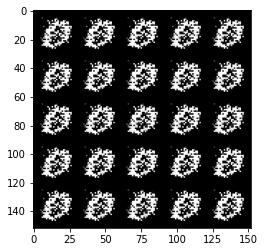

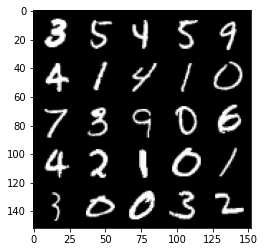

  0%|          | 0/469 [00:00<?, ?it/s]

Step 41000: Generator loss: 8.248819500923151, discriminator loss: 0.003828120944956028


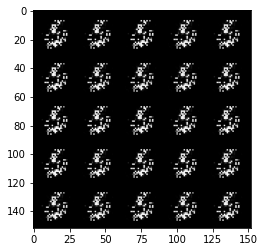

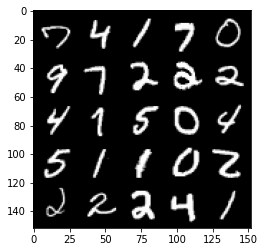

  0%|          | 0/469 [00:00<?, ?it/s]

Step 41500: Generator loss: 6.892634842872626, discriminator loss: 0.003614976747310719


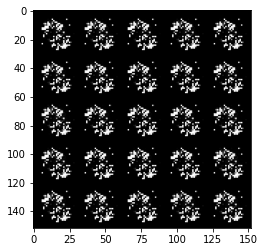

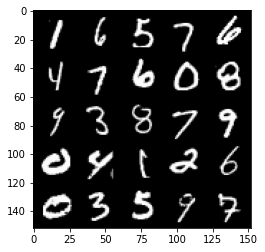

  0%|          | 0/469 [00:00<?, ?it/s]

Step 42000: Generator loss: 8.294181686401375, discriminator loss: 0.003790258173066831


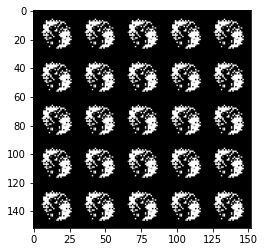

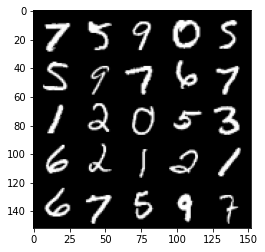

  0%|          | 0/469 [00:00<?, ?it/s]

Step 42500: Generator loss: 8.139863615989684, discriminator loss: 0.003166197302547518


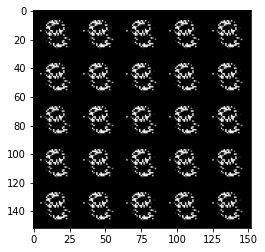

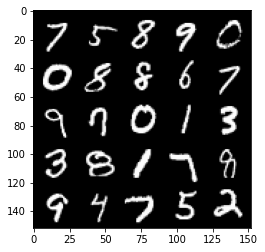

  0%|          | 0/469 [00:00<?, ?it/s]

Step 43000: Generator loss: 7.064155846595766, discriminator loss: 0.0030136862047220364


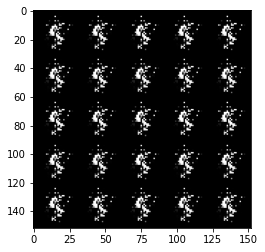

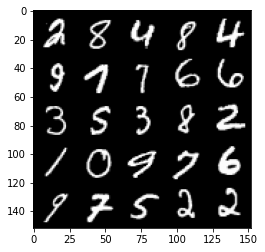

  0%|          | 0/469 [00:00<?, ?it/s]

Step 43500: Generator loss: 6.737576125144958, discriminator loss: 0.003954332559194884


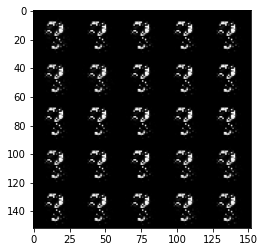

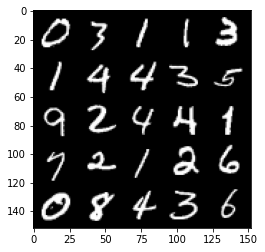

  0%|          | 0/469 [00:00<?, ?it/s]

Step 44000: Generator loss: 6.81411768627166, discriminator loss: 0.00794267178449081


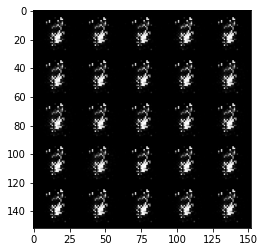

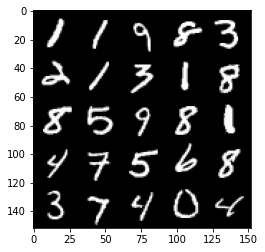

  0%|          | 0/469 [00:00<?, ?it/s]

Step 44500: Generator loss: 6.769798847198487, discriminator loss: 0.008790279894194099


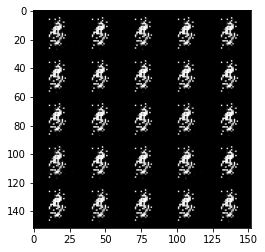

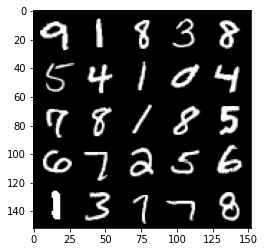

  0%|          | 0/469 [00:00<?, ?it/s]

Step 45000: Generator loss: 7.388070346832283, discriminator loss: 0.008276231665644439


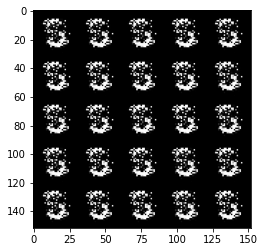

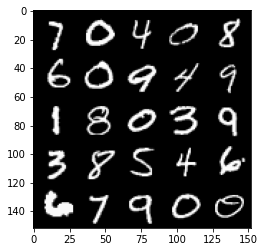

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 45500: Generator loss: 7.166735081672666, discriminator loss: 0.005237719295342686


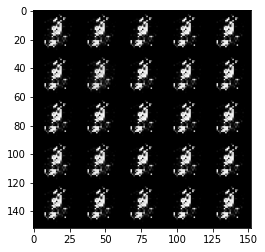

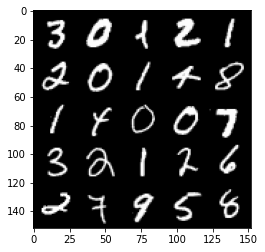

  0%|          | 0/469 [00:00<?, ?it/s]

Step 46000: Generator loss: 8.30620882225037, discriminator loss: 0.0061408773553557686


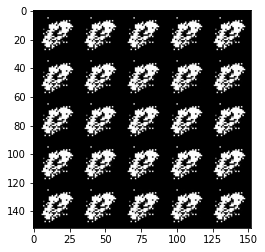

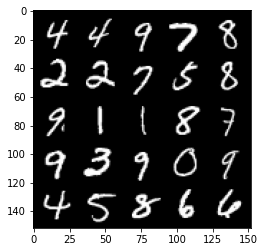

  0%|          | 0/469 [00:00<?, ?it/s]

Step 46500: Generator loss: 8.305061294555669, discriminator loss: 0.0015953286991389178


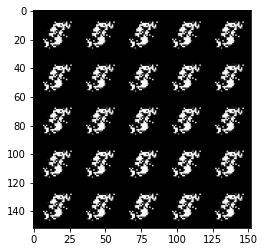

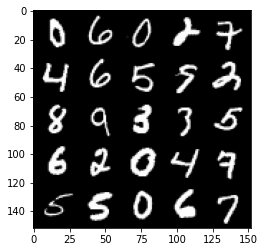

  0%|          | 0/469 [00:00<?, ?it/s]

Step 47000: Generator loss: 7.265509411811824, discriminator loss: 0.002557012235716682


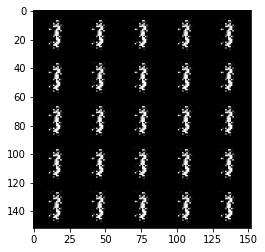

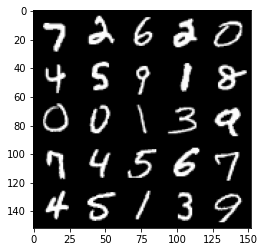

  0%|          | 0/469 [00:00<?, ?it/s]

Step 47500: Generator loss: 7.2499141035079955, discriminator loss: 0.003478290941318849


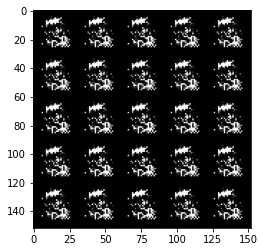

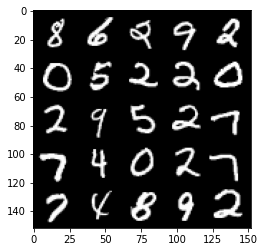

  0%|          | 0/469 [00:00<?, ?it/s]

Step 48000: Generator loss: 8.731914966583252, discriminator loss: 0.0025435132976444957


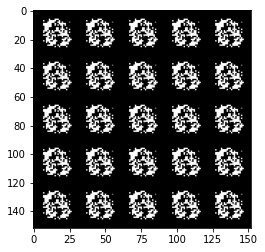

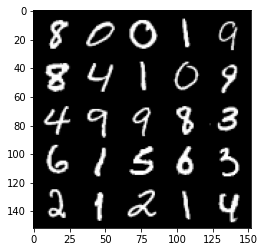

  0%|          | 0/469 [00:00<?, ?it/s]

Step 48500: Generator loss: 9.032104461669933, discriminator loss: 0.000919083165423217


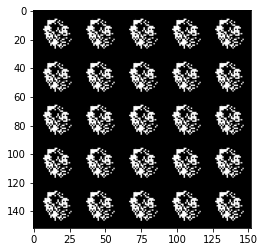

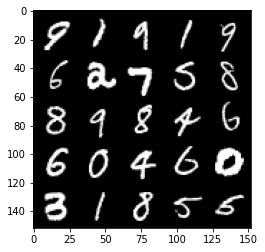

  0%|          | 0/469 [00:00<?, ?it/s]

Step 49000: Generator loss: 7.855329855918885, discriminator loss: 0.002595826853370455


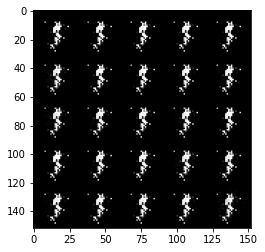

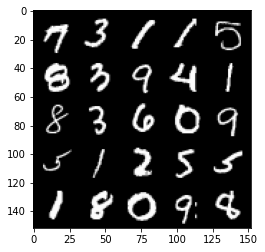

  0%|          | 0/469 [00:00<?, ?it/s]

Step 49500: Generator loss: 8.235594609260563, discriminator loss: 0.0022520331937821536


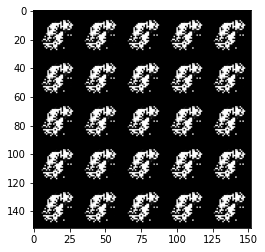

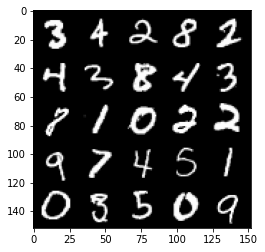

  0%|          | 0/469 [00:00<?, ?it/s]

Step 50000: Generator loss: 9.281051706314086, discriminator loss: 0.0006444409349528543


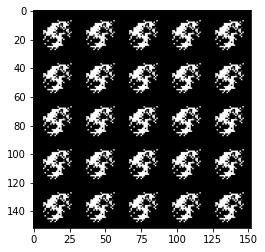

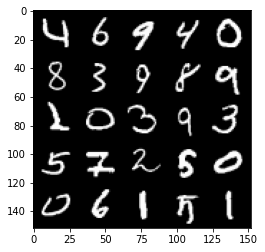

  0%|          | 0/469 [00:00<?, ?it/s]

Step 50500: Generator loss: 7.501646821022021, discriminator loss: 0.004431262288508155


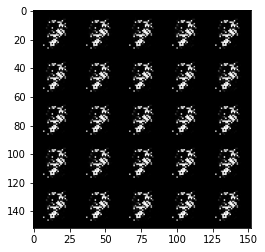

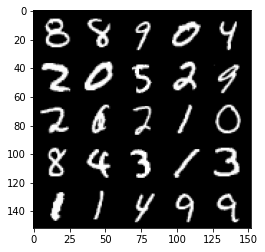

  0%|          | 0/469 [00:00<?, ?it/s]

Step 51000: Generator loss: 7.898009379386901, discriminator loss: 0.0019477740210350003


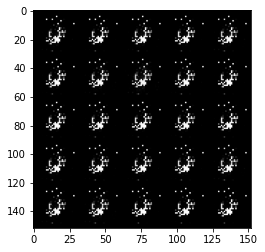

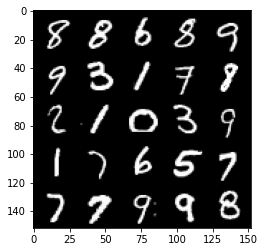

  0%|          | 0/469 [00:00<?, ?it/s]

Step 51500: Generator loss: 7.195726164817808, discriminator loss: 0.0033330812201929805


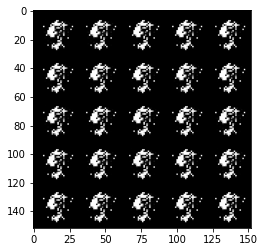

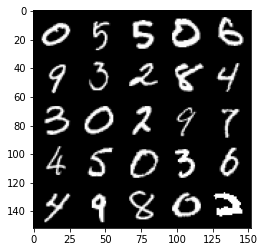

  0%|          | 0/469 [00:00<?, ?it/s]

Step 52000: Generator loss: 8.291723902702334, discriminator loss: 0.00208193053449577


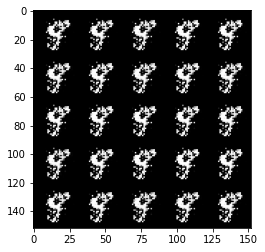

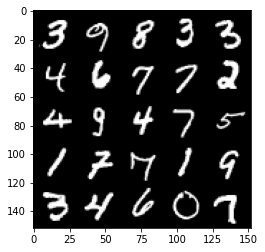

  0%|          | 0/469 [00:00<?, ?it/s]

Step 52500: Generator loss: 7.239749614715574, discriminator loss: 0.005102835103200048


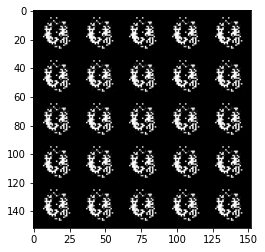

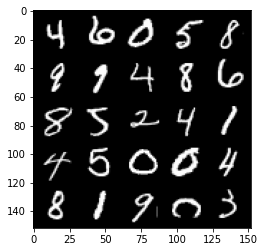

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 53000: Generator loss: 8.834673096656797, discriminator loss: 0.0016778057040000946


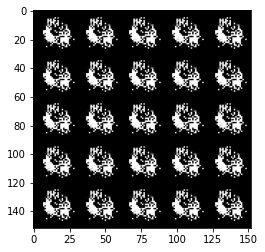

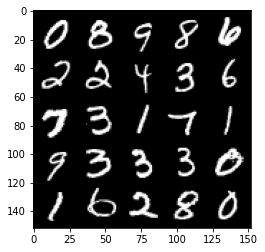

  0%|          | 0/469 [00:00<?, ?it/s]

Step 53500: Generator loss: 9.276124908447267, discriminator loss: 0.002097385316988976


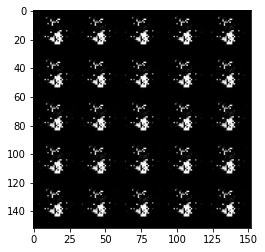

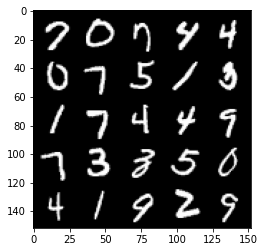

  0%|          | 0/469 [00:00<?, ?it/s]

Step 54000: Generator loss: 7.823788250923155, discriminator loss: 0.003597647836297255


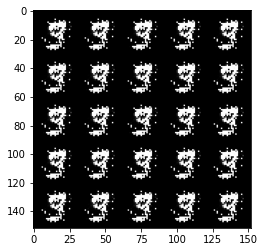

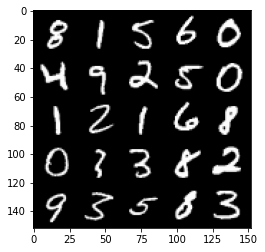

  0%|          | 0/469 [00:00<?, ?it/s]

Step 54500: Generator loss: 9.370042386054992, discriminator loss: 0.0007125825382503308


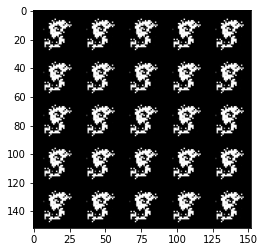

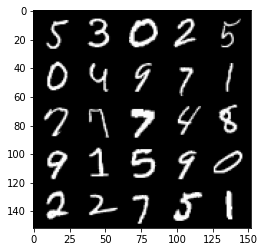

  0%|          | 0/469 [00:00<?, ?it/s]

Step 55000: Generator loss: 8.8193931722641, discriminator loss: 0.0010004887480206438


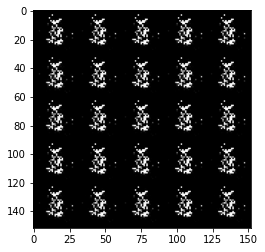

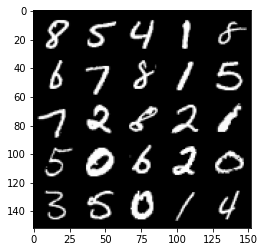

  0%|          | 0/469 [00:00<?, ?it/s]

Step 55500: Generator loss: 8.19051225280762, discriminator loss: 0.0019128448258743443


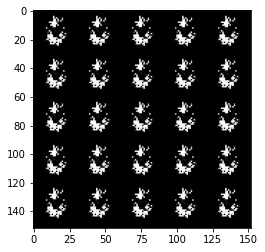

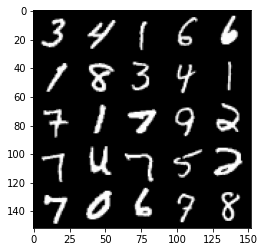

  0%|          | 0/469 [00:00<?, ?it/s]

Step 56000: Generator loss: 8.49848968410492, discriminator loss: 0.001042396620116052


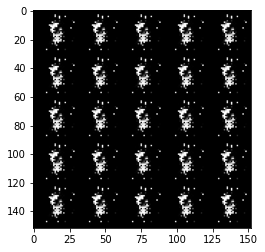

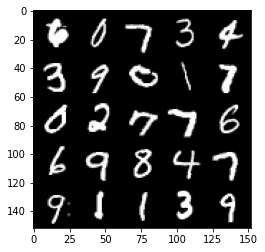

  0%|          | 0/469 [00:00<?, ?it/s]

Step 56500: Generator loss: 8.411885062217706, discriminator loss: 0.0014875123633646588


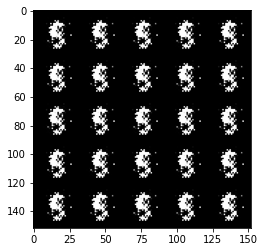

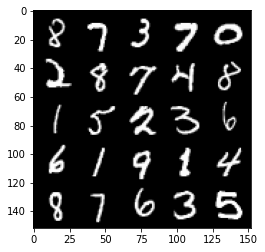

  0%|          | 0/469 [00:00<?, ?it/s]

Step 57000: Generator loss: 9.781976678848281, discriminator loss: 0.0011152226814518812


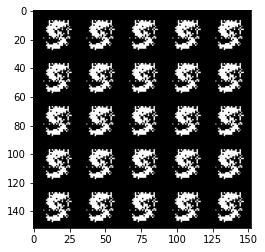

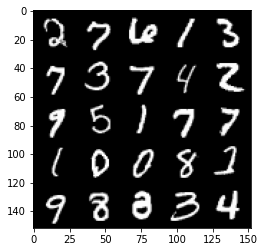

  0%|          | 0/469 [00:00<?, ?it/s]

Step 57500: Generator loss: 10.328693697929387, discriminator loss: 0.00033385056836988264


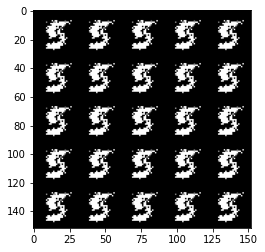

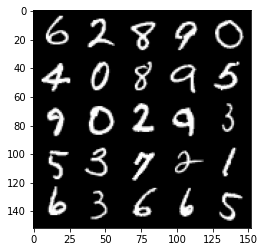

  0%|          | 0/469 [00:00<?, ?it/s]

Step 58000: Generator loss: 10.340871253013608, discriminator loss: 0.0005951440808141799


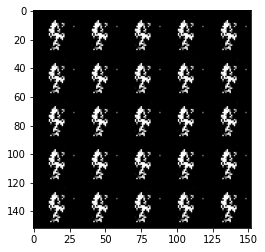

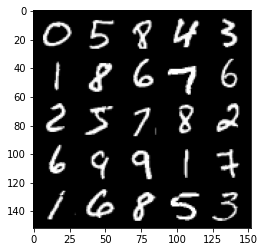

  0%|          | 0/469 [00:00<?, ?it/s]

Step 58500: Generator loss: 8.904264682769778, discriminator loss: 0.0014377481650801646


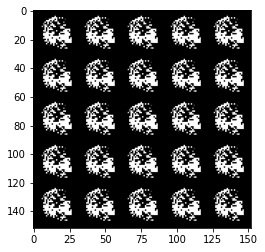

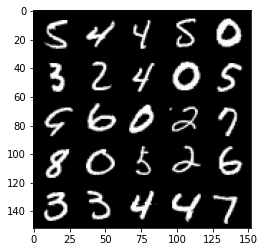

  0%|          | 0/469 [00:00<?, ?it/s]

Step 59000: Generator loss: 11.57352358436585, discriminator loss: 0.0003598183631059265


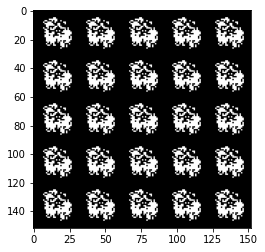

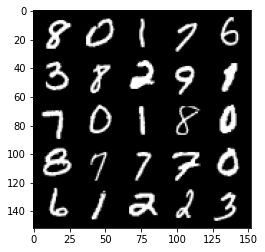

  0%|          | 0/469 [00:00<?, ?it/s]

Step 59500: Generator loss: 11.119203454017645, discriminator loss: 0.00039405696735890543


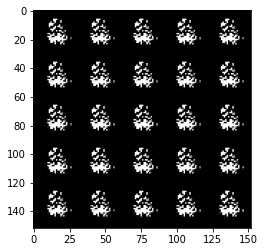

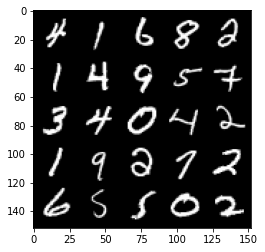

  0%|          | 0/469 [00:00<?, ?it/s]

Step 60000: Generator loss: 8.824038197517398, discriminator loss: 0.001062942670232587


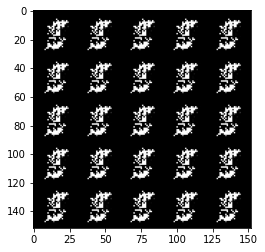

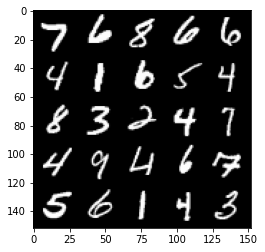

  0%|          | 0/469 [00:00<?, ?it/s]

Step 60500: Generator loss: 10.300701963424688, discriminator loss: 0.0008628986231202372


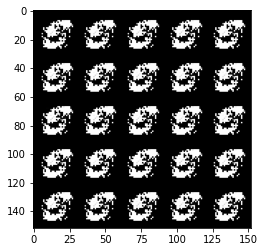

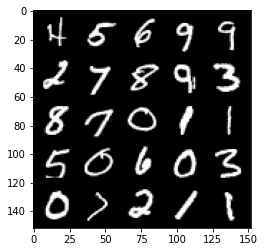

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 61000: Generator loss: 12.06895330905915, discriminator loss: 0.00028574013017836883


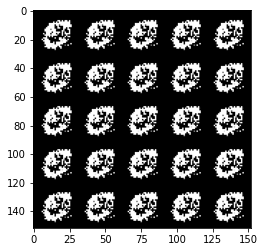

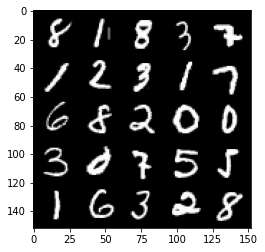

  0%|          | 0/469 [00:00<?, ?it/s]

Step 61500: Generator loss: 12.782728006362913, discriminator loss: 6.752247494102594e-05


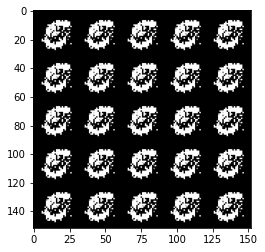

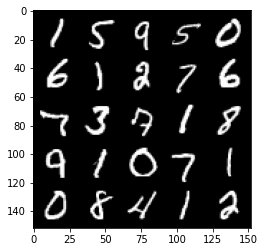

  0%|          | 0/469 [00:00<?, ?it/s]

Step 62000: Generator loss: 11.754159001350414, discriminator loss: 6.044073416764678e-05


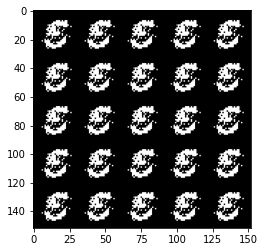

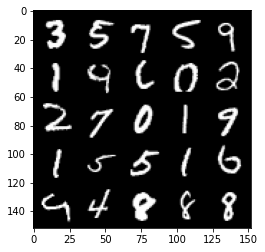

  0%|          | 0/469 [00:00<?, ?it/s]

Step 62500: Generator loss: 10.855235486984263, discriminator loss: 0.0011593273273693637


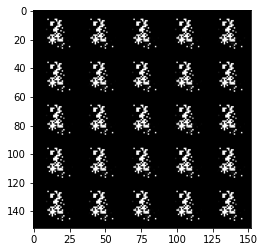

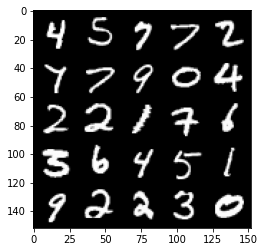

  0%|          | 0/469 [00:00<?, ?it/s]

Step 63000: Generator loss: 9.848121499061588, discriminator loss: 0.0005209473089019518


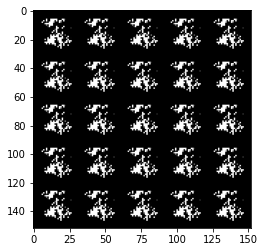

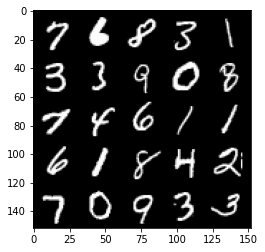

  0%|          | 0/469 [00:00<?, ?it/s]

Step 63500: Generator loss: 10.645183775901804, discriminator loss: 0.00027598199155539737


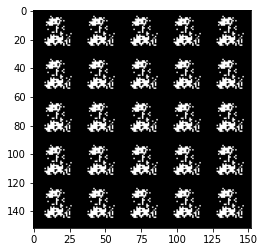

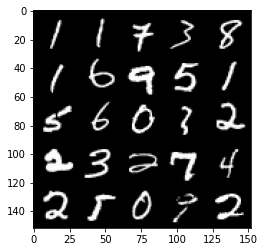

  0%|          | 0/469 [00:00<?, ?it/s]

Step 64000: Generator loss: 10.604935600280765, discriminator loss: 0.00013494232638072397


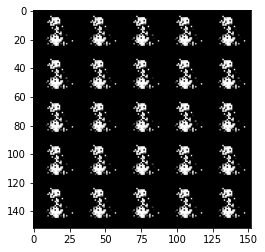

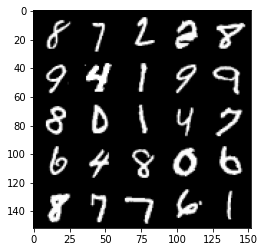

  0%|          | 0/469 [00:00<?, ?it/s]

Step 64500: Generator loss: 9.45497968673706, discriminator loss: 0.0016958020115375827


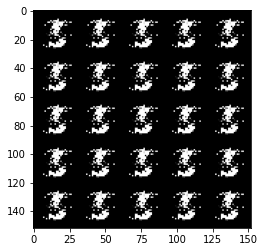

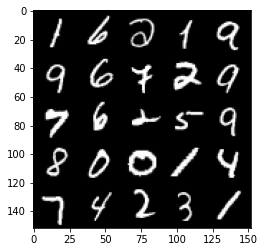

  0%|          | 0/469 [00:00<?, ?it/s]

Step 65000: Generator loss: 9.751849478721619, discriminator loss: 0.0007206390235365916


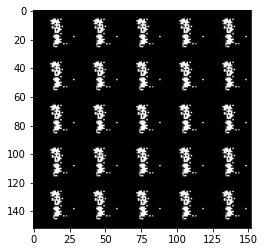

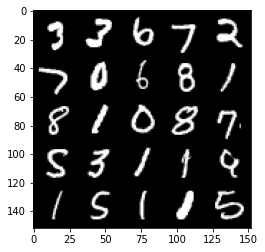

  0%|          | 0/469 [00:00<?, ?it/s]

Step 65500: Generator loss: 9.557790555000306, discriminator loss: 0.0005068401236821957


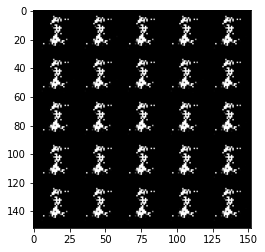

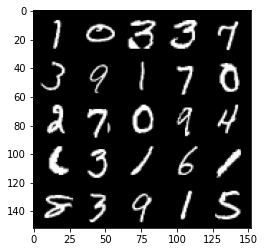

  0%|          | 0/469 [00:00<?, ?it/s]

Step 66000: Generator loss: 9.835383602142329, discriminator loss: 0.00020647090747343114


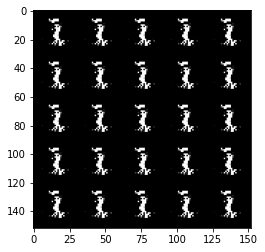

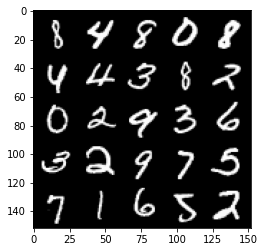

  0%|          | 0/469 [00:00<?, ?it/s]

Step 66500: Generator loss: 9.682335824966446, discriminator loss: 0.00014037542595815456


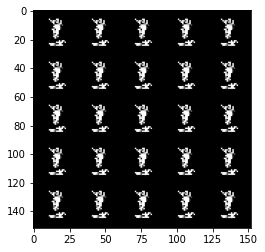

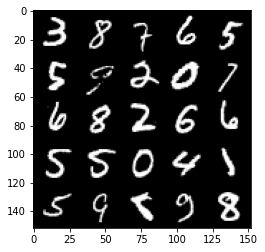

  0%|          | 0/469 [00:00<?, ?it/s]

Step 67000: Generator loss: 11.684766120910641, discriminator loss: 0.000593543879552581


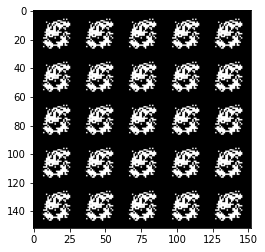

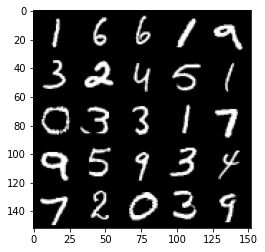

  0%|          | 0/469 [00:00<?, ?it/s]

Step 67500: Generator loss: 12.687945342063895, discriminator loss: 0.0002022830299563245


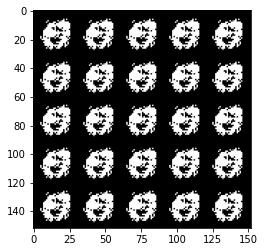

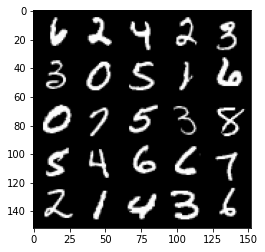

  0%|          | 0/469 [00:00<?, ?it/s]

Step 68000: Generator loss: 12.869821600913996, discriminator loss: 3.4995983712970524e-05


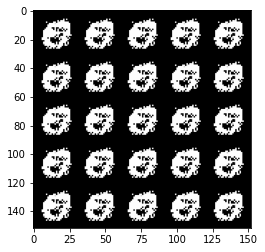

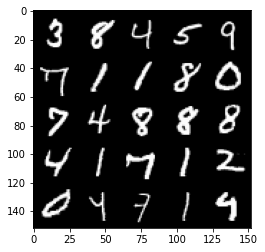

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 68500: Generator loss: 12.596306770324704, discriminator loss: 5.674097579003504e-06


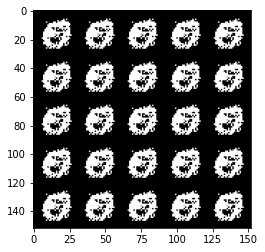

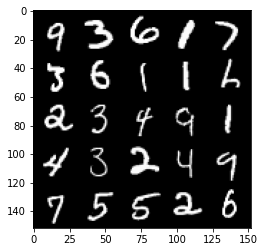

  0%|          | 0/469 [00:00<?, ?it/s]

Step 69000: Generator loss: 14.871709010124208, discriminator loss: 3.899045914202885e-05


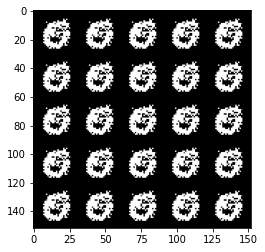

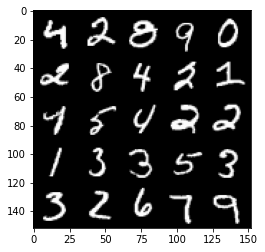

  0%|          | 0/469 [00:00<?, ?it/s]

Step 69500: Generator loss: 13.897912528038031, discriminator loss: 0.0009854263346972451


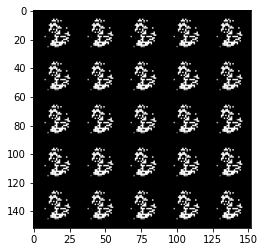

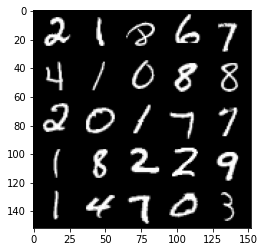

  0%|          | 0/469 [00:00<?, ?it/s]

Step 70000: Generator loss: 9.638818557739251, discriminator loss: 0.0016999424110363186


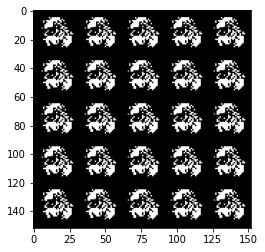

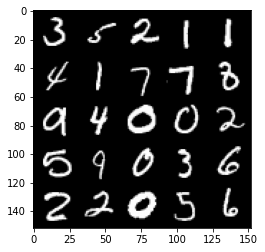

  0%|          | 0/469 [00:00<?, ?it/s]

Step 70500: Generator loss: 11.407847539901733, discriminator loss: 0.00010745479364178152


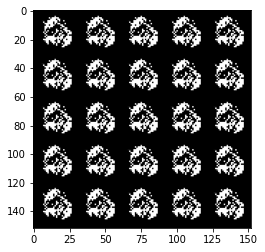

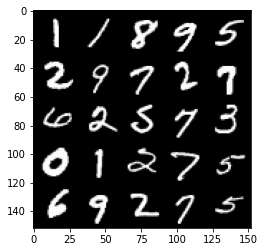

  0%|          | 0/469 [00:00<?, ?it/s]

Step 71000: Generator loss: 12.428297749519352, discriminator loss: 0.00011909731833304322


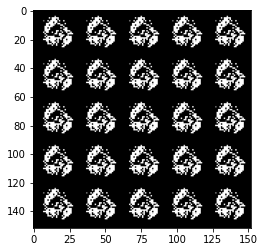

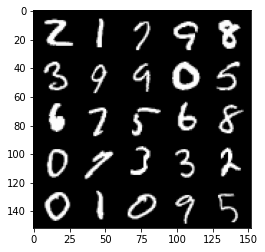

  0%|          | 0/469 [00:00<?, ?it/s]

Step 71500: Generator loss: 11.215618266105649, discriminator loss: 5.0504385684106935e-05


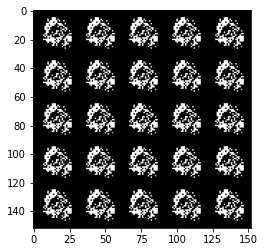

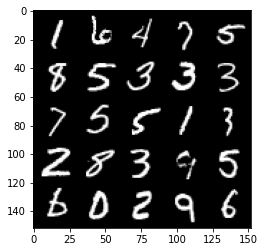

  0%|          | 0/469 [00:00<?, ?it/s]

Step 72000: Generator loss: 12.129805087089535, discriminator loss: 2.5858185525862595e-05


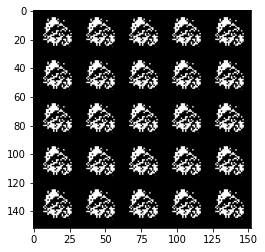

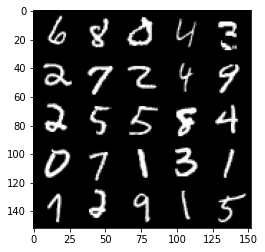

  0%|          | 0/469 [00:00<?, ?it/s]

Step 72500: Generator loss: 11.809608804702762, discriminator loss: 2.7969628466408386e-05


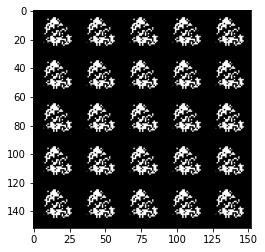

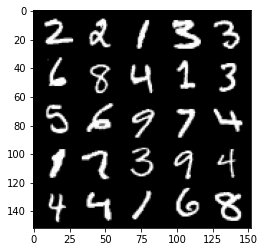

  0%|          | 0/469 [00:00<?, ?it/s]

Step 73000: Generator loss: 10.452532608985907, discriminator loss: 0.0006181376033976281


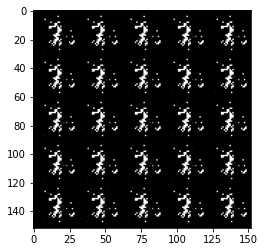

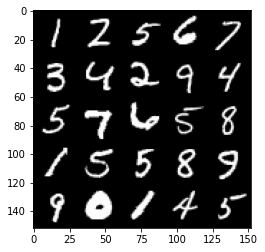

  0%|          | 0/469 [00:00<?, ?it/s]

Step 73500: Generator loss: 9.683530440330518, discriminator loss: 0.0007230579216188741


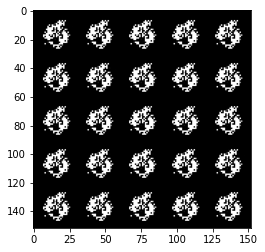

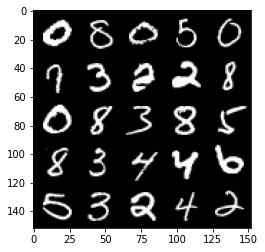

  0%|          | 0/469 [00:00<?, ?it/s]

Step 74000: Generator loss: 11.66803067874909, discriminator loss: 0.00029029354922962376


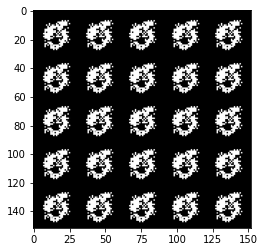

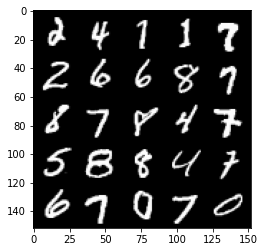

  0%|          | 0/469 [00:00<?, ?it/s]

Step 74500: Generator loss: 14.11743875646592, discriminator loss: 0.00035247392720421376


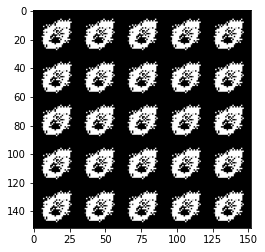

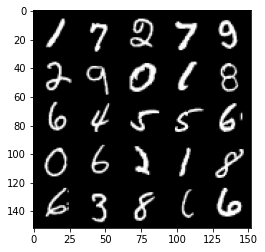

  0%|          | 0/469 [00:00<?, ?it/s]

Step 75000: Generator loss: 12.862087803840629, discriminator loss: 0.00011438978321094195


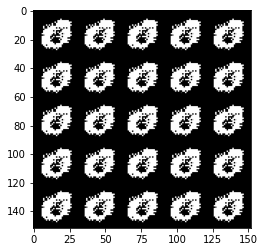

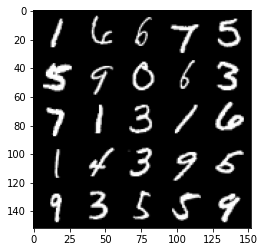

  0%|          | 0/469 [00:00<?, ?it/s]

Step 75500: Generator loss: 14.989168834686284, discriminator loss: 3.0647653503060185e-05


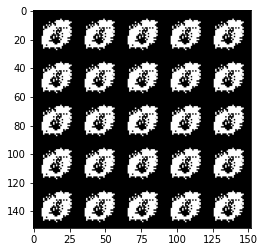

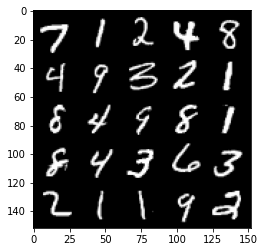

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 76000: Generator loss: 14.920516020774844, discriminator loss: 7.4044357166655495e-06


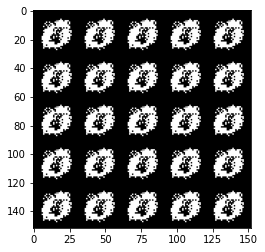

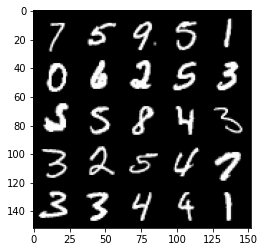

  0%|          | 0/469 [00:00<?, ?it/s]

Step 76500: Generator loss: 17.270393868446366, discriminator loss: 4.6187435092687156e-05


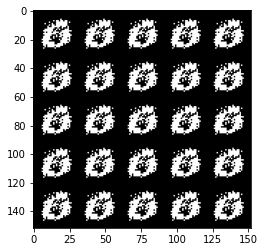

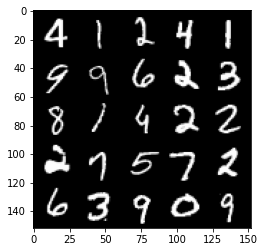

  0%|          | 0/469 [00:00<?, ?it/s]

Step 77000: Generator loss: 13.92597276687622, discriminator loss: 0.0020150991908967405


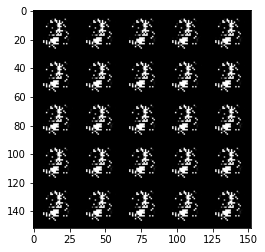

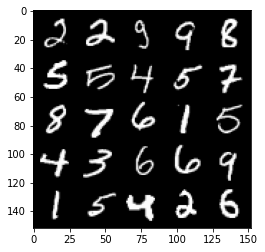

  0%|          | 0/469 [00:00<?, ?it/s]

Step 77500: Generator loss: 10.163323445320117, discriminator loss: 0.0019101230659292216


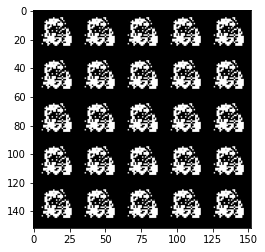

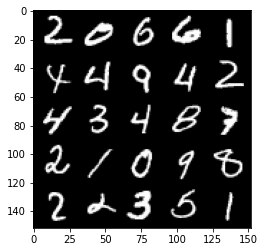

  0%|          | 0/469 [00:00<?, ?it/s]

Step 78000: Generator loss: 11.052671521186824, discriminator loss: 0.00025907588792142643


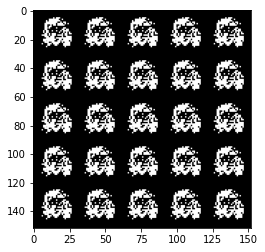

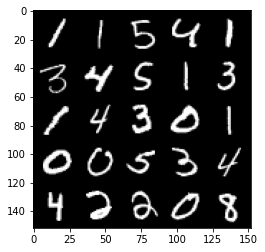

  0%|          | 0/469 [00:00<?, ?it/s]

Step 78500: Generator loss: 11.941911142349237, discriminator loss: 3.986592188664419e-05


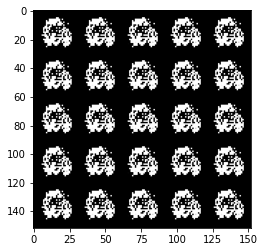

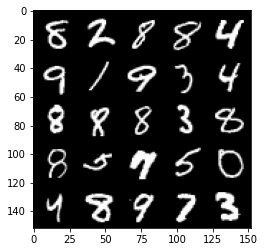

  0%|          | 0/469 [00:00<?, ?it/s]

Step 79000: Generator loss: 11.992483118057242, discriminator loss: 3.112583855102002e-05


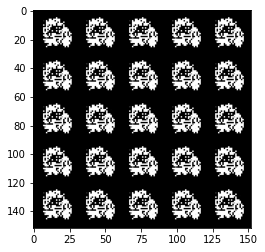

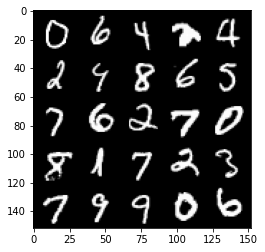

  0%|          | 0/469 [00:00<?, ?it/s]

Step 79500: Generator loss: 12.440240142822264, discriminator loss: 7.096732669879204e-06


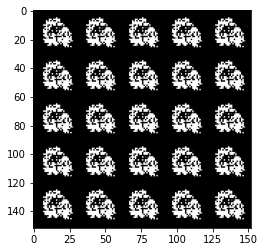

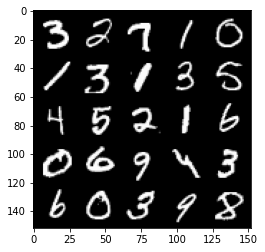

  0%|          | 0/469 [00:00<?, ?it/s]

Step 80000: Generator loss: 12.542945910453799, discriminator loss: 2.2999708154495887e-05


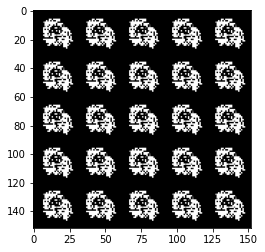

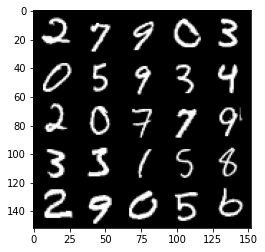

  0%|          | 0/469 [00:00<?, ?it/s]

Step 80500: Generator loss: 12.773170654296882, discriminator loss: 9.747476084467629e-06


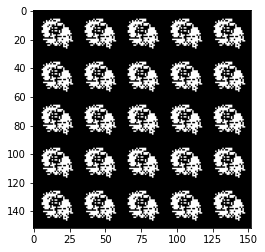

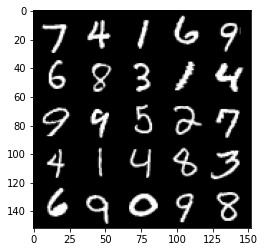

  0%|          | 0/469 [00:00<?, ?it/s]

Step 81000: Generator loss: 13.570417299270618, discriminator loss: 1.9502513636666683e-06


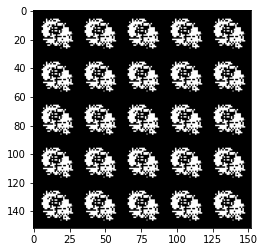

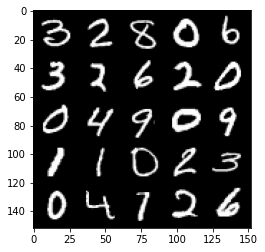

  0%|          | 0/469 [00:00<?, ?it/s]

Step 81500: Generator loss: 13.86881998443603, discriminator loss: 1.5834973520441045e-06


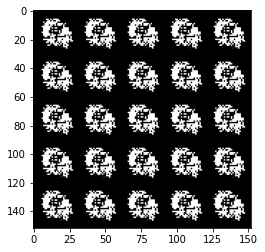

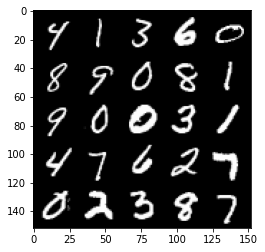

  0%|          | 0/469 [00:00<?, ?it/s]

Step 82000: Generator loss: 13.576688310623178, discriminator loss: 2.2074885781080364e-06


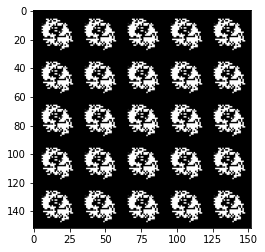

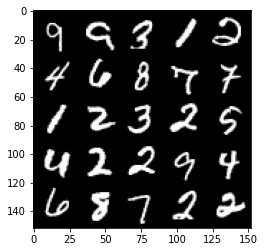

  0%|          | 0/469 [00:00<?, ?it/s]

Step 82500: Generator loss: 13.382207939147948, discriminator loss: 2.506925851690767e-06


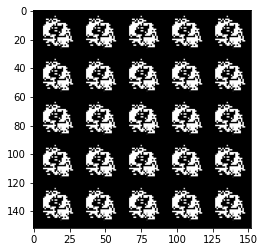

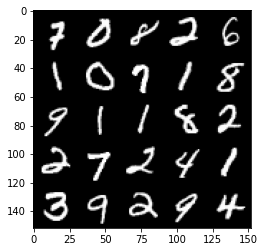

  0%|          | 0/469 [00:00<?, ?it/s]

Step 83000: Generator loss: 14.698341611862185, discriminator loss: 3.0006636290012507e-06


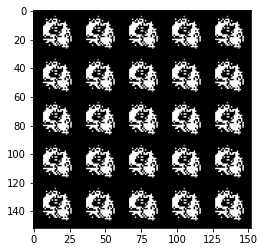

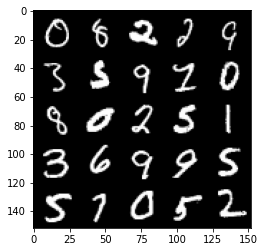

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 83500: Generator loss: 16.87362966728211, discriminator loss: 2.030789266376787e-07


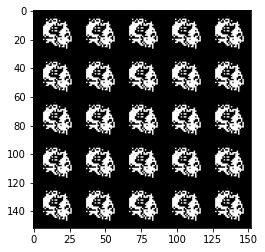

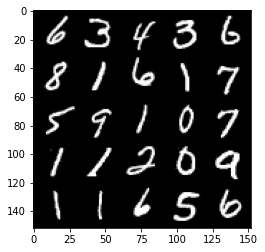

  0%|          | 0/469 [00:00<?, ?it/s]

Step 84000: Generator loss: 12.88765824747085, discriminator loss: 0.0018487619456630862


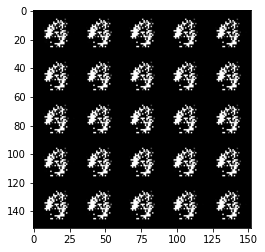

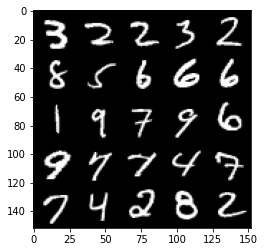

  0%|          | 0/469 [00:00<?, ?it/s]

Step 84500: Generator loss: 10.661987911224374, discriminator loss: 0.0021950144828218414


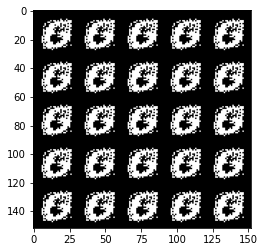

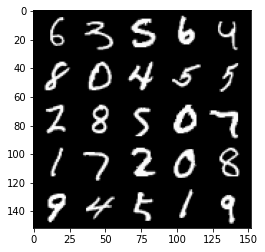

  0%|          | 0/469 [00:00<?, ?it/s]

Step 85000: Generator loss: 11.437720763206487, discriminator loss: 0.000106077990457834


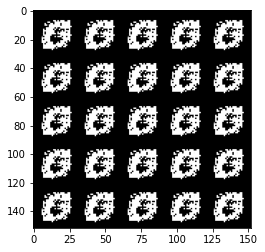

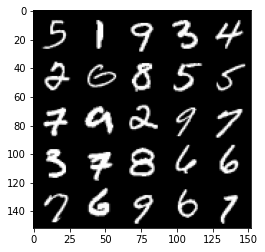

  0%|          | 0/469 [00:00<?, ?it/s]

Step 85500: Generator loss: 12.517955260276795, discriminator loss: 7.434496821855429e-05


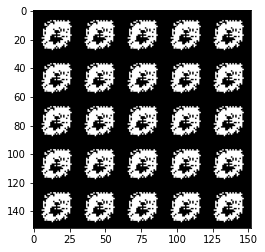

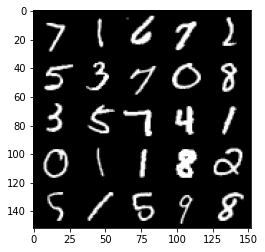

  0%|          | 0/469 [00:00<?, ?it/s]

Step 86000: Generator loss: 12.676502180099494, discriminator loss: 8.423302548660022e-05


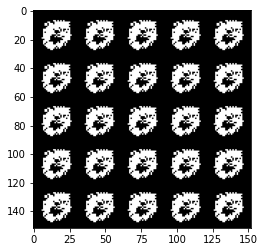

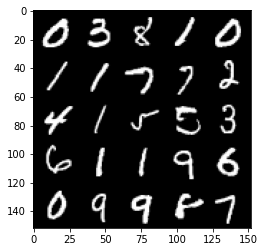

  0%|          | 0/469 [00:00<?, ?it/s]

Step 86500: Generator loss: 12.559509828567498, discriminator loss: 6.4915714325479655e-06


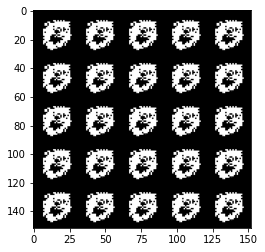

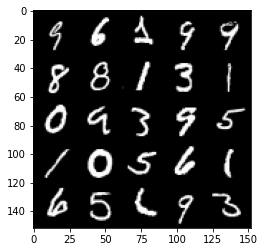

  0%|          | 0/469 [00:00<?, ?it/s]

Step 87000: Generator loss: 13.142094681739803, discriminator loss: 2.1680335318850766e-05


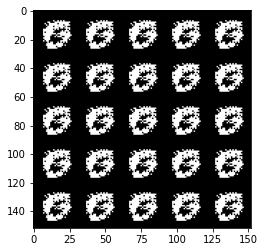

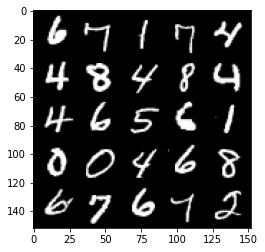

  0%|          | 0/469 [00:00<?, ?it/s]

Step 87500: Generator loss: 12.285034711837763, discriminator loss: 1.3449560880644629e-05


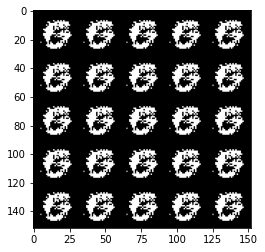

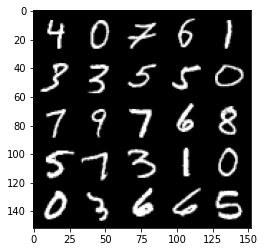

  0%|          | 0/469 [00:00<?, ?it/s]

Step 88000: Generator loss: 10.335482425689706, discriminator loss: 0.002517758072261053


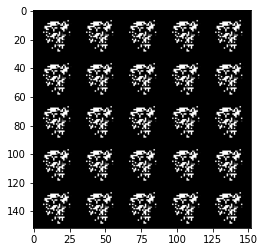

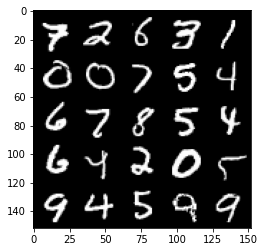

  0%|          | 0/469 [00:00<?, ?it/s]

Step 88500: Generator loss: 10.241300292968749, discriminator loss: 0.000568711199032904


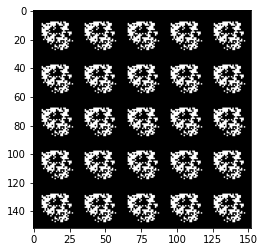

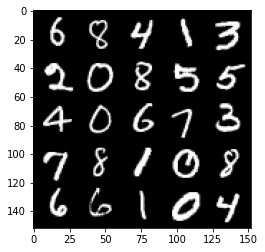

  0%|          | 0/469 [00:00<?, ?it/s]

Step 89000: Generator loss: 12.862958321571348, discriminator loss: 0.00014052140936235614


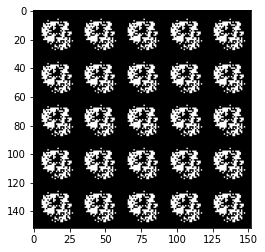

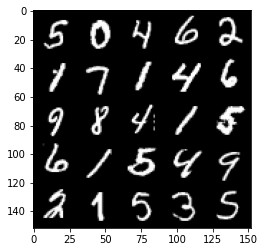

  0%|          | 0/469 [00:00<?, ?it/s]

Step 89500: Generator loss: 12.429248523712166, discriminator loss: 1.1113501276440728e-05


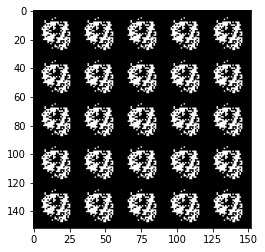

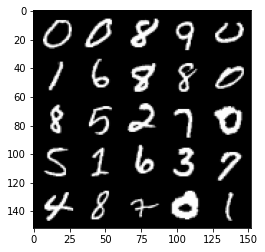

  0%|          | 0/469 [00:00<?, ?it/s]

Step 90000: Generator loss: 12.05146879196166, discriminator loss: 1.2913243704815625e-05


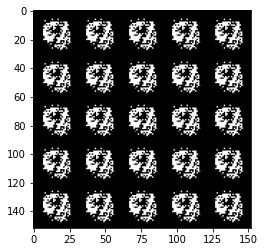

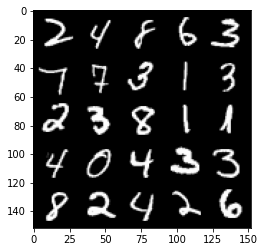

  0%|          | 0/469 [00:00<?, ?it/s]

Step 90500: Generator loss: 12.579071573257448, discriminator loss: 1.8739593118311868e-05


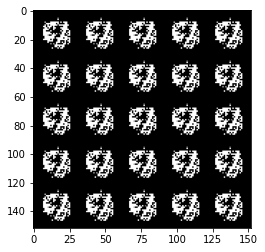

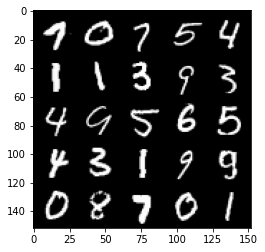

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 91000: Generator loss: 12.817161197662351, discriminator loss: 4.381545977253154e-06


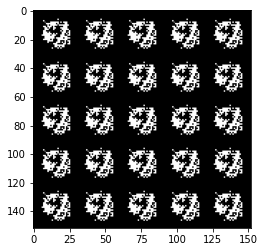

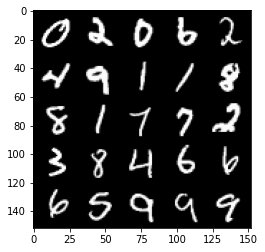

  0%|          | 0/469 [00:00<?, ?it/s]

Step 91500: Generator loss: 13.277353404998788, discriminator loss: 4.745610348891208e-06


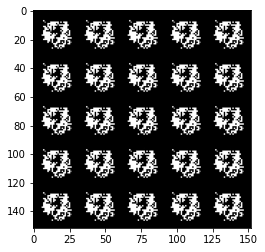

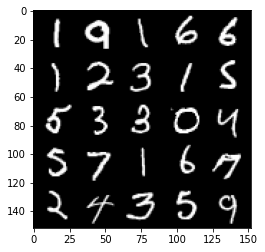

  0%|          | 0/469 [00:00<?, ?it/s]

Step 92000: Generator loss: 13.982337038040153, discriminator loss: 1.3190299189034236e-06


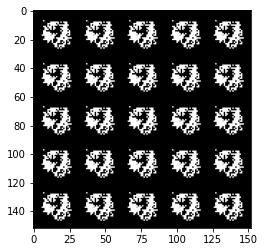

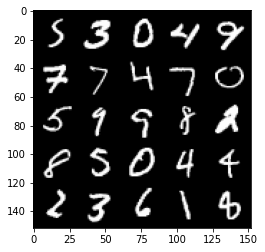

  0%|          | 0/469 [00:00<?, ?it/s]

Step 92500: Generator loss: 13.81272274589539, discriminator loss: 1.5883211188452125e-06


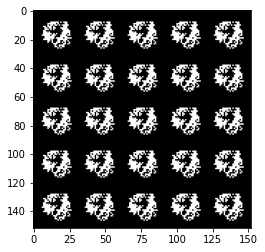

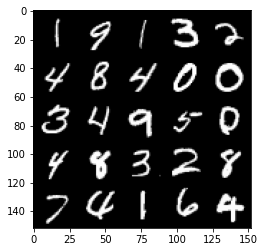

  0%|          | 0/469 [00:00<?, ?it/s]

Step 93000: Generator loss: 14.365540639877324, discriminator loss: 9.88729407794155e-07


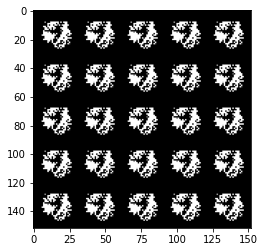

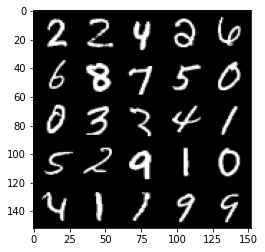

  0%|          | 0/469 [00:00<?, ?it/s]

Step 93500: Generator loss: 14.169771913528445, discriminator loss: 9.919567835083835e-07


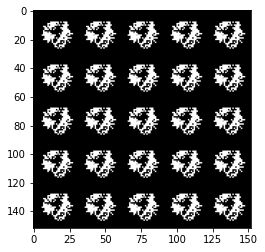

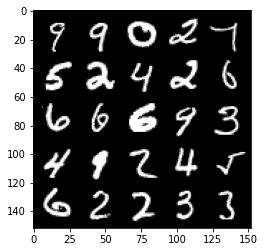

In [27]:
# UNQ_C8 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: 

cur_step = 0
mean_generator_loss = 0
mean_discriminator_loss = 0
test_generator = True # Whether the generator should be tested
gen_loss = False
error = False
for epoch in range(n_epochs):
  
    # Dataloader returns the batches
    for real, _ in tqdm(dataloader):
        cur_batch_size = len(real)

        # Flatten the batch of real images from the dataset
        real = real.view(cur_batch_size, -1).to(device)

        ### Update discriminator ###
        # Zero out the gradients before backpropagation
        disc_opt.zero_grad()

        # Calculate discriminator loss
        disc_loss = get_disc_loss(gen, disc, criterion, real, cur_batch_size, z_dim, device)

        # Update gradients
        disc_loss.backward(retain_graph=True)

        # Update optimizer
        disc_opt.step()

        # For testing purposes, to keep track of the generator weights
        if test_generator:
            old_generator_weights = gen.gen[0][0].weight.detach().clone()

        ### Update generator ###
        #     Hint: This code will look a lot like the discriminator updates!
        #     These are the steps you will need to complete:
        #       1) Zero out the gradients.
        #       2) Calculate the generator loss, assigning it to gen_loss.
        #       3) Backprop through the generator: update the gradients and optimizer.
        #### START CODE HERE ####
        gen_opt.zero_grad()
        gen_loss = get_gen_loss(gen, disc, criterion, cur_batch_size, z_dim, device)
        gen_loss.backward()
        gen_opt.step()
        #### END CODE HERE ####

        # For testing purposes, to check that your code changes the generator weights
        if test_generator:
            try:
                assert lr > 0.0000002 or (gen.gen[0][0].weight.grad.abs().max() < 0.0005 and epoch == 0)
                assert torch.any(gen.gen[0][0].weight.detach().clone() != old_generator_weights)
            except:
                error = True
                print("Runtime tests have failed")

        # Keep track of the average discriminator loss
        mean_discriminator_loss += disc_loss.item() / display_step

        # Keep track of the average generator loss
        mean_generator_loss += gen_loss.item() / display_step

        ### Visualization code ###
        if cur_step % display_step == 0 and cur_step > 0:
            print(f"Step {cur_step}: Generator loss: {mean_generator_loss}, discriminator loss: {mean_discriminator_loss}")
            fake_noise = get_noise(cur_batch_size, z_dim, device=device)
            fake = gen(fake_noise)
            show_tensor_images(fake)
            show_tensor_images(real)
            mean_generator_loss = 0
            mean_discriminator_loss = 0
        cur_step += 1